In [ ]:
!pip install ftfy regex tqdm

In [ ]:
!pip install git+https://github.com/openai/CLIP.git

# В условиях ограниченного времени хакатона и отсутствия данных, не получилось бы обучить под каждое требование модель для качественных предсказаний, потому было принято решение использовать [CLIP](https://github.com/OpenAI/CLIP) для *zero-shot transfer learning*
*MIT лицензия позволяет использовать данную нейросеть без ограничений для коммерческого использования*

Берем сеть CLIP, один раз прогоняем через Text Encoder, получаем векторные репрезентации текстовых описаний. Этот процесс не нужно повторять, так как для каждого изображения в новом датасете мы будем будем искать максимально соответствующее текстовое описание все в том же списке. Получение векторов классов на основании текстовых описаний есть процесс "обучения без обучения".    
    
Это возможно лишь потому, что исходная нейросеть предобучалась на колоссальном по размеру датасете пар изображение-текст, и способна не только понимать, что на изображении котик или собачка, как это делают большинство классификаторов, а полностью репрезентировать весь контекст

***Данное решение показывает возможности нейросетевого подхода, но для внедрения решения в бизнес, необходимо дообучение модели на соответственных данных, чтобы получилось более робастное решение***

In [6]:
import torch
import clip
from PIL import Image
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)

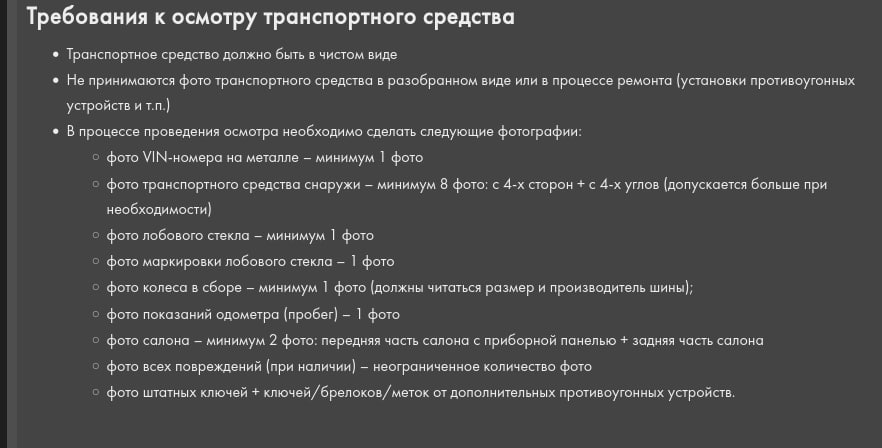

# Чистая/грязная

In [7]:
def clean_repair(image, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then car clean and not under repair, else if flag = 1 user have to make another photo of it
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["dirty car", "clean car", "car"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("car clean probs:", probs) # [[dirt, clean]]

    if probs[0][0] > probs[0][1] and probs[0][0] > probs[0][2]:
        flag = 1
        print('Ваша машина слишком грязная, пожалуйста, почистите её перед фото')


    text = clip.tokenize(["disassembled car", "the whole car"]).to(device)    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()
    print("car repair probs:", probs) # [[under repair, in good condition]]

    if probs[0][0] > probs[0][1]:
        print('не принимаются фото автомобиля в разобранном виде или в процессе ремонта')
        flag = 1
    return flag    

    

car clean probs: [[0.1519  0.01434 0.834  ]]
car repair probs: [[0.1294 0.8706]]


0

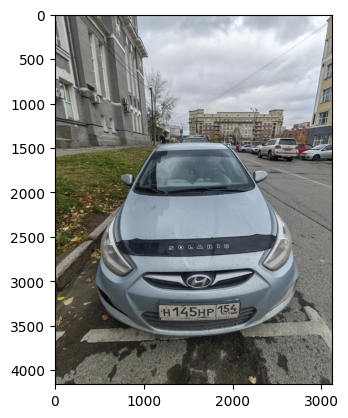

In [8]:
img = Image.open("front.jpg")
clean_repair(img)

car clean probs: [[0.2188 0.0411 0.74  ]]
car repair probs: [[0.3174 0.6826]]


0

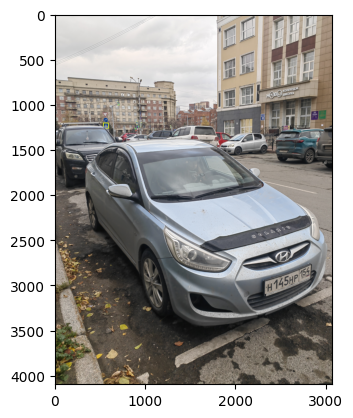

In [9]:
img = Image.open("angle.jpg")
clean_repair(img)

car clean probs: [[0.1771 0.326  0.4968]]
car repair probs: [[0.02759 0.9727 ]]


0

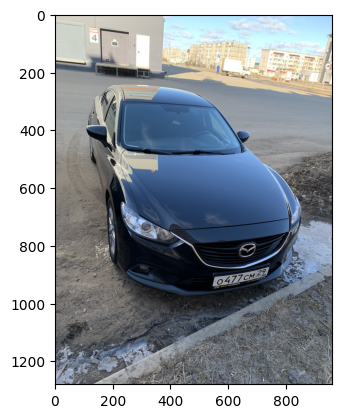

In [10]:
img = Image.open("clean_car.jpg")
clean_repair(img)

car clean probs: [[0.9307   0.002827 0.0664  ]]
Ваша машина слишком грязная, пожалуйста, почистите её перед фото
car repair probs: [[0.3074 0.693 ]]


1

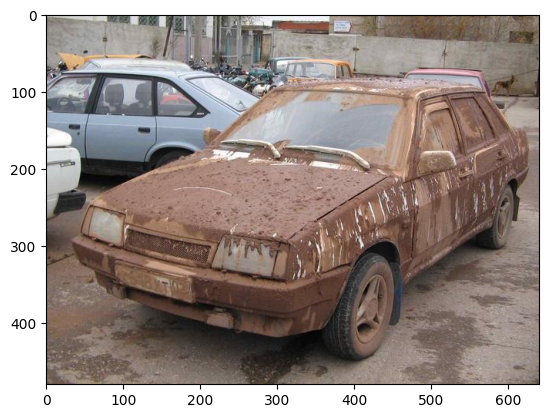

In [11]:
img = Image.open("dirty_car.jpg")
clean_repair(img)

car clean probs: [[0.1406 0.2391 0.62  ]]
car repair probs: [[0.98    0.02002]]
не принимаются фото автомобиля в разобранном виде или в процессе ремонта


1

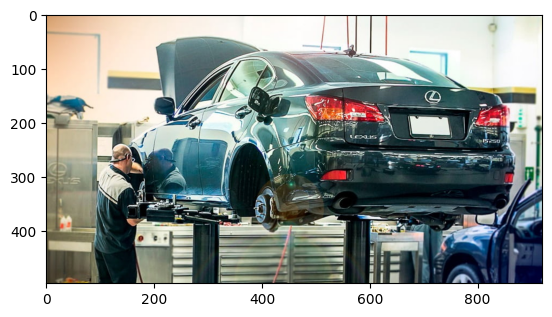

In [12]:
img = Image.open("repair_car.jpg")
clean_repair(img)

# VIN номер

In [13]:
# !pip install easyocr

In [14]:
# import easyocr
# reader = easyocr.Reader(['en'])

In [15]:
def vin_number(img, device=device, model=model, preprocess=preprocess): # ocr=reader
    """
        returns flag: if flag equals 0 then vin number on the car metal body, else if flag = 1 user have to make another photo of it 
        TODO: OCR model for 
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["VIN number on the car metal body", "not a VIN number", "car"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("vin probs:", probs) # [[vin on a metal body, not vin]]

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0]:
        flag = 1
        print('нужна фотография VIN на металле')
        
#     else:
#         vin = ocr.readtxt(img)
#         for res in vin:
#             vin_len = len(res[1])
#             print('VIN:', res[1])
#             print('VIN length:', vin_len)
#             if (vil_len != 17):
#                 flag = 1
#                 print('на фотографии не разобрать VIN')
#             else:  # вдруг на металле выбиты ещё символы
#                 flag = 0
        

## тут стоило бы прикрутить ocr
    return flag    

vin probs: [[0.9487  0.01793 0.03348]]


0

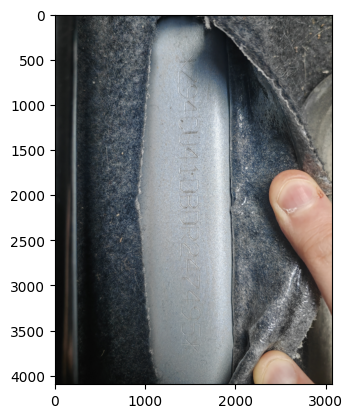

In [16]:
img = Image.open('my_vin.jpg')
vin_number(img)

vin probs: [[0.001725 0.001132 0.997   ]]
нужна фотография VIN на металле


1

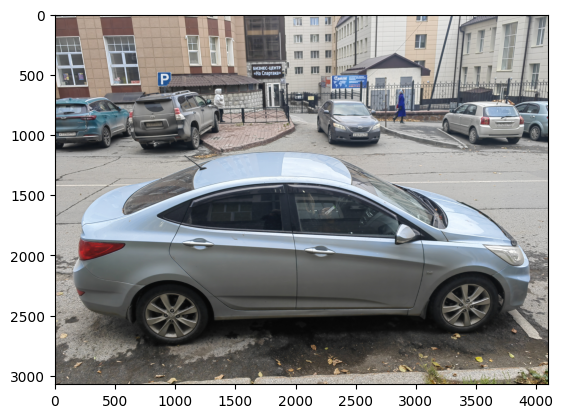

In [17]:
img = Image.open('my_car.jpg')
vin_number(img)

In [18]:
img = Image.open('vin_2.jpg')

vin probs: [[0.9927   0.00521  0.002071]]


0

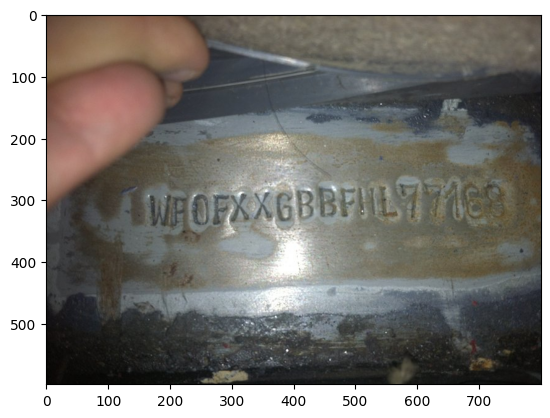

In [19]:
vin_number(img)

vin probs: [[9.966e-01 7.653e-04 2.712e-03]]


0

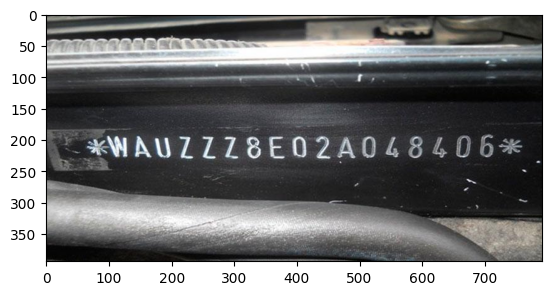

In [20]:
img = Image.open('vin.jpg')
vin_number(img)

vin probs: [[0.2112 0.491  0.2979]]
нужна фотография VIN на металле


1

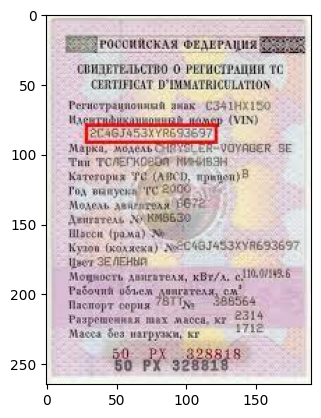

In [21]:
img = Image.open('vin_not_cat.jpeg')
vin_number(img)

vin probs: [[0.056 0.108 0.836]]
нужна фотография VIN на металле


1

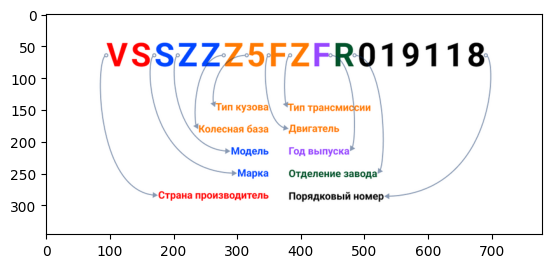

In [22]:
img = Image.open('vin.png')
vin_number(img)

In [23]:
# results = reader.readtext(img)

In [24]:
# results

In [25]:
# for res in results:
#     print('VIN:', res[1])
#     print('VIN length:', len(res[1]))

# В бот должно отправляться 8+ фотографий машины снаружи

In [155]:
def car_outside_photo(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its a car photo, else if flag = 1 looks like its not a real car or not outside
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["car or car outside", "drawing of a car", "car interior"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("car outside probs:", probs) 

    if probs[0][1] > probs[0][0]:
        flag = 1
        print('требуются фотографии настоящей машины')
    elif probs[0][2] > probs[0][0]:
        flag = 1
        print('требуются фотографии машины снаружи, заполняющей большую часть кадра')    

    return flag  

car outside probs: [[0.987    0.004864 0.00841 ]]


0

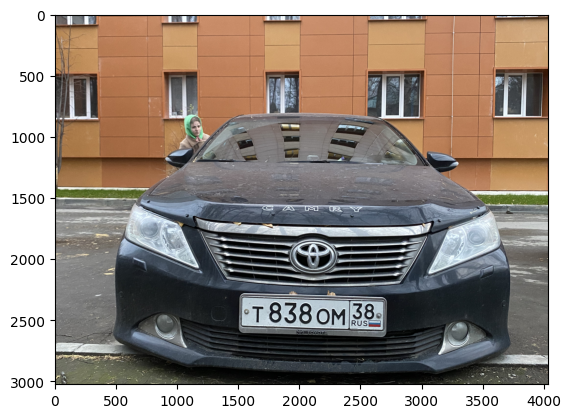

In [156]:
img = Image.open('car_july.jpg')
car_outside_photo(img)

car outside probs: [[0.9927  0.00474 0.00246]]


0

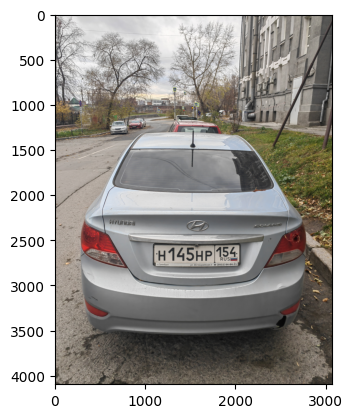

In [157]:
img = Image.open('my_car_2.jpg')
car_outside_photo(img)

car outside probs: [[9.893e-01 1.016e-02 5.822e-04]]


0

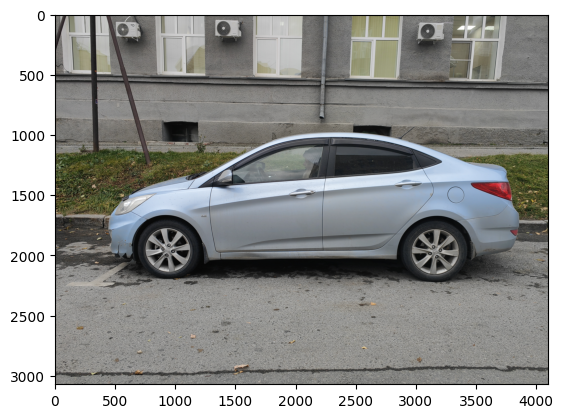

In [158]:
img = Image.open('my_car_1.jpg')
car_outside_photo(img)

car outside probs: [[2.800e-03 9.971e-01 5.376e-05]]
требуются фотографии настоящей машины


1

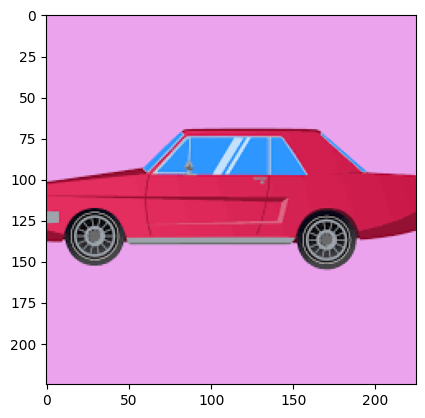

In [159]:
img = Image.open('fake_car.png')
car_outside_photo(img)

car outside probs: [[0.9653   0.03354  0.001281]]


0

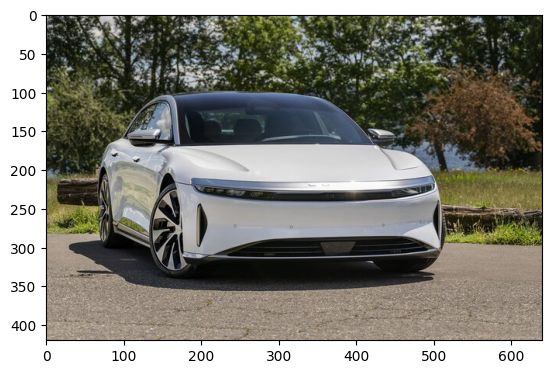

In [160]:
img = Image.open('white_car.jpg')
car_outside_photo(img)

car outside probs: [[0.9546  0.0376  0.00788]]


0

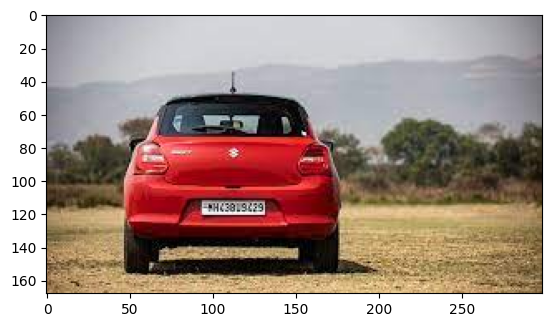

In [161]:
img = Image.open('red_car.jpeg')
car_outside_photo(img)

car outside probs: [[0.00829  0.002491 0.9893  ]]
требуются фотографии машины снаружи, заполняющей большую часть кадра


1

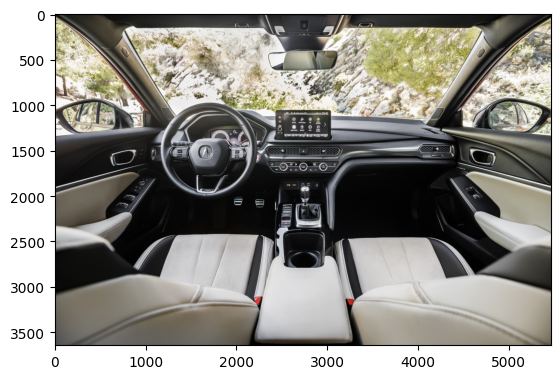

In [162]:
img = Image.open('car_inside.jpg')
car_outside_photo(img)

# Фото лобового стекла

In [33]:
def car_windshield(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its a windshield of a car, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["car windshield close photo", "windshield drawing", "photo of the whole car", "not a car"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("windshield probs:", probs) 

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0] or probs[0][3] > probs[0][0]:
        flag = 1
        print('Требуется фотография лобового стекла настоящего автомобиля крупным планом') 
        

    return flag  

windshield probs: [[0.6953   0.2223   0.0756   0.006607]]


0

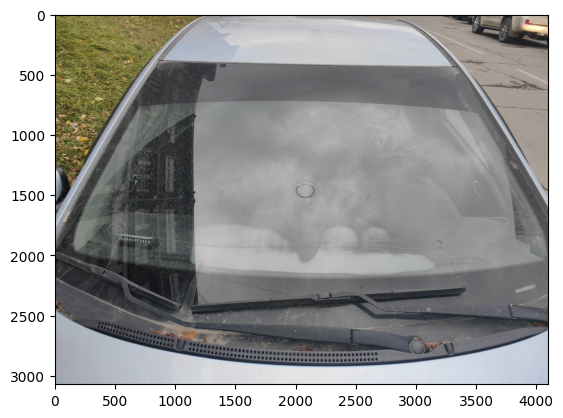

In [34]:
img = Image.open('my_windshield.jpg')
car_windshield(img)

windshield probs: [[8.203e-02 3.514e-04 1.632e-01 7.544e-01]]
Требуется фотография лобового стекла настоящего автомобиля крупным планом


1

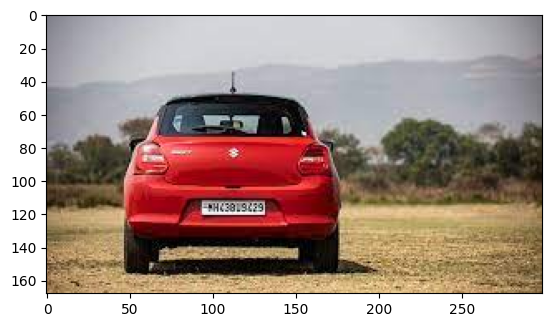

In [35]:
img = Image.open('red_car.jpeg')
car_windshield(img)

windshield probs: [[0.5444   0.4446   0.00937  0.001506]]


0

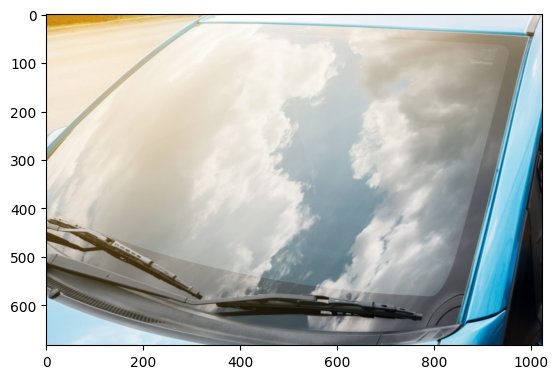

In [36]:
img = Image.open('car_windshield.jpg')
car_windshield(img)

windshield probs: [[0.428   0.04727 0.4849  0.0398 ]]
Требуется фотография лобового стекла настоящего автомобиля крупным планом


1

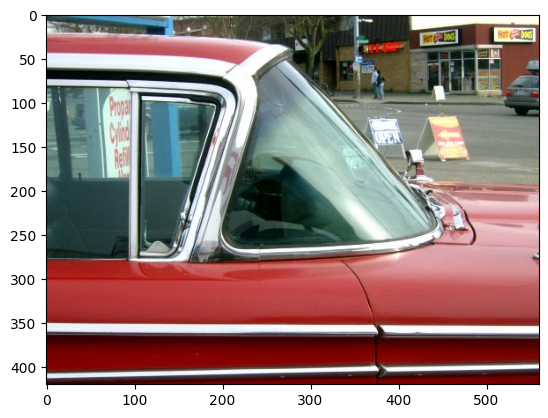

In [37]:
img = Image.open('not_a_windshield.JPG')
car_windshield(img)

windshield probs: [[0.05618  0.9355   0.002932 0.00539 ]]
Требуется фотография лобового стекла настоящего автомобиля крупным планом


1

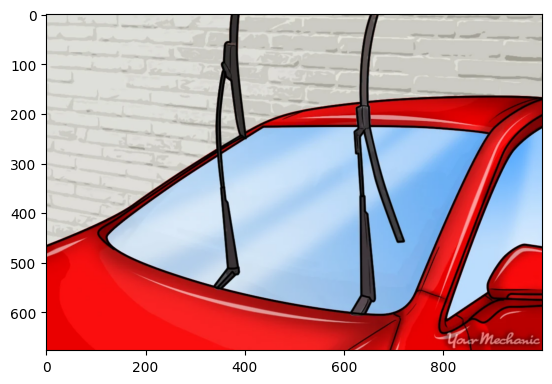

In [38]:
img = Image.open('fake_windshield.webp')
car_windshield(img)

# фото маркировки лобового стекла

In [39]:
def car_windshield_markings(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its a windshield markings of a car, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["identification label on a real car windshield", "markings or identification label not on a car windshield", "windshield without markings"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("windshield markings probs:", probs) 

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0]:
        flag = 1
        print('Требуется фотография маркировки на лобовом стекле') 
        

    return flag  

windshield markings probs: [[0.764   0.1993  0.03632]]


0

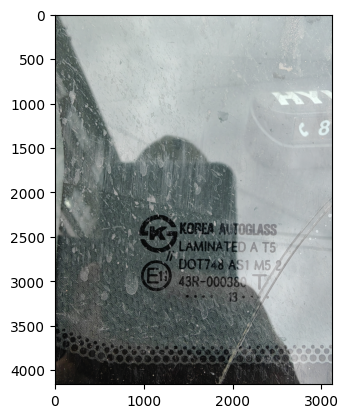

In [40]:
img = Image.open('my_windshield_markings.jpg')
car_windshield_markings(img)

windshield markings probs: [[0.0239  0.02142 0.9546 ]]
Требуется фотография маркировки на лобовом стекле


1

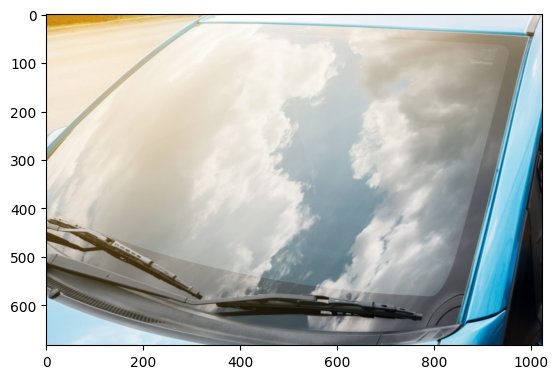

In [41]:
img = Image.open('car_windshield.jpg')
car_windshield_markings(img)

windshield markings probs: [[0.5107  0.4797  0.00965]]


0

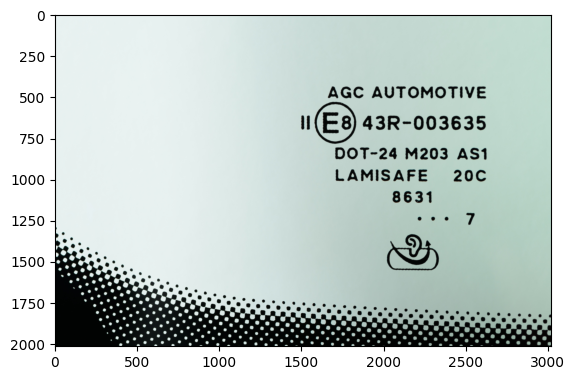

In [42]:
img = Image.open('windshield_markings.jpg')
car_windshield_markings(img)

windshield markings probs: [[0.641   0.338   0.02126]]


0

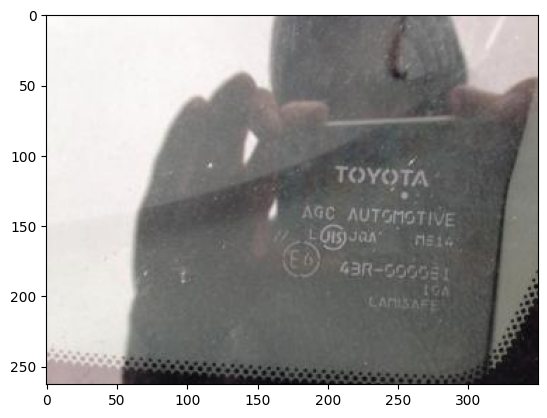

In [43]:
img = Image.open('windshield_markings_2.jpg')
car_windshield_markings(img)

windshield markings probs: [[9.528e-02 9.043e-01 4.773e-04]]
Требуется фотография маркировки на лобовом стекле


1

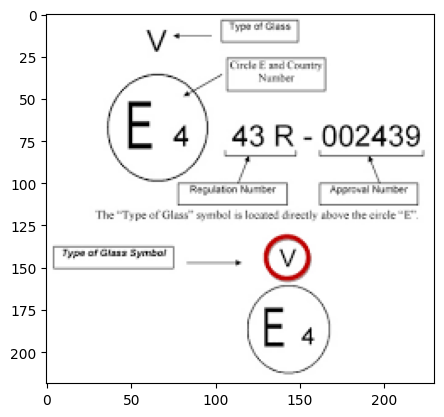

In [44]:
img = Image.open('markings_not_windshield.png')
car_windshield_markings(img)

# Фото колеса в сборе (должны читаться размер и производитель шин), минимум 1 фото

In [45]:
def car_wheel(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["photo of the assembled wheel with an inscription about the size and manufacturer", "photo of the disassembled wheel", "wheel without an inscription or not a wheel"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("wheel probs:", probs) 

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0]:
        flag = 1
        print('Требуется фотография колеса в сборе, должны читаться размер и производитель шин') 
        

    return flag  

wheel probs: [[0.04666 0.5176  0.4358 ]]
Требуется фотография колеса в сборе, должны читаться размер и производитель шин


1

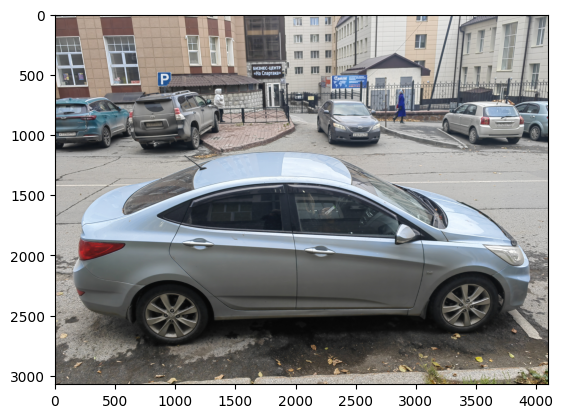

In [46]:
img = Image.open('my_car.jpg')
car_wheel(img)

wheel probs: [[0.0801 0.681  0.239 ]]
Требуется фотография колеса в сборе, должны читаться размер и производитель шин


1

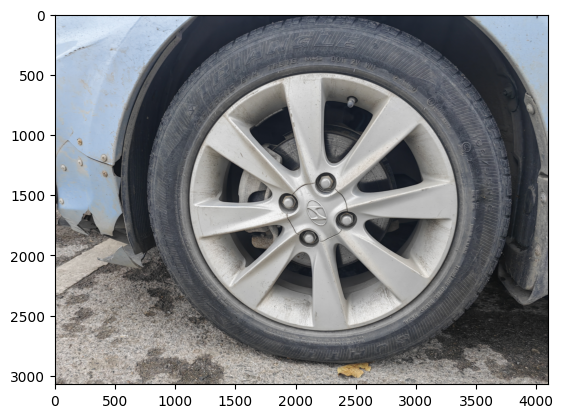

In [47]:
img = Image.open('my_wheel_1.jpg')
car_wheel(img)

wheel probs: [[0.76   0.145  0.0951]]


0

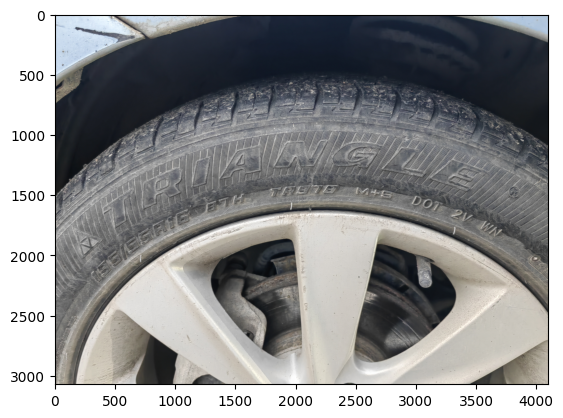

In [48]:
img = Image.open('my_wheel_2.jpg')
car_wheel(img)

wheel probs: [[0.1659 0.417  0.417 ]]
Требуется фотография колеса в сборе, должны читаться размер и производитель шин


1

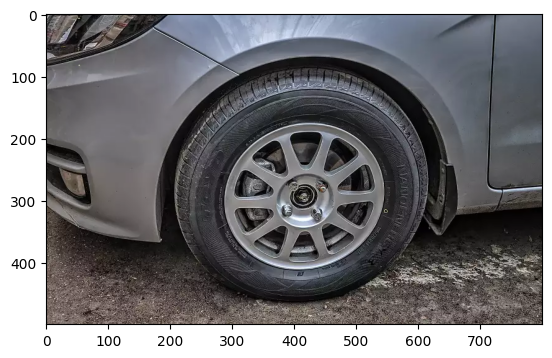

In [49]:
img = Image.open('wheel.webp')
car_wheel(img)

wheel probs: [[0.45    0.543   0.00716]]
Требуется фотография колеса в сборе, должны читаться размер и производитель шин


1

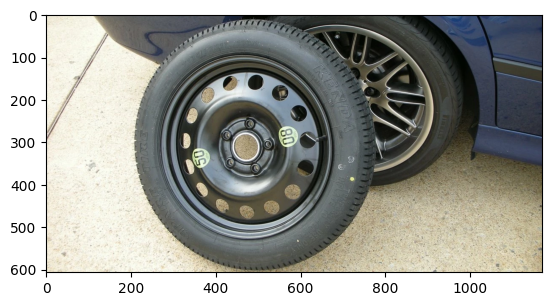

In [50]:
img = Image.open('disassembled_wheel_2.webp')
car_wheel(img)

wheel probs: [[0.738  0.0841 0.178 ]]


0

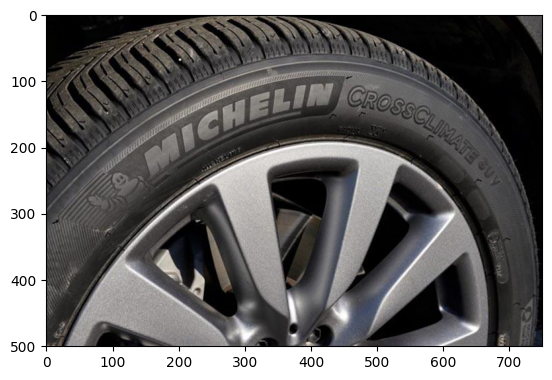

In [51]:
img = Image.open('good_wheel.jpg')
car_wheel(img)

# Фото одометра с пробегом

In [52]:
def mileage_odometer(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["photo of an odometer with mileage", "odometer without mileage numbers", "not an odometer"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("odometer probs:", probs) 

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0]:
        flag = 1
        print('Требуется фотография одометра, где виден пробег') 
        

    return flag  

odometer probs: [[0.5483  0.4014  0.05023]]


0

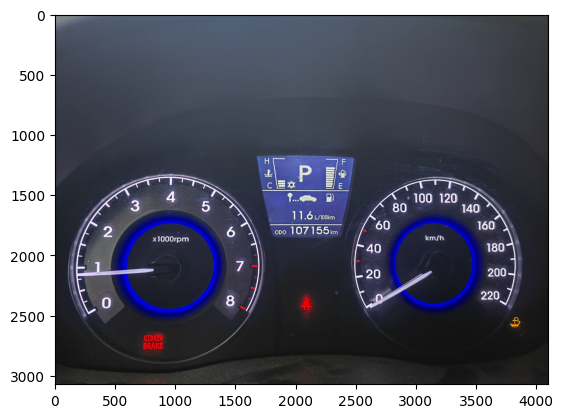

In [53]:
img = Image.open('my_odo.jpg')
mileage_odometer(img)

odometer probs: [[0.894  0.0972 0.0085]]


0

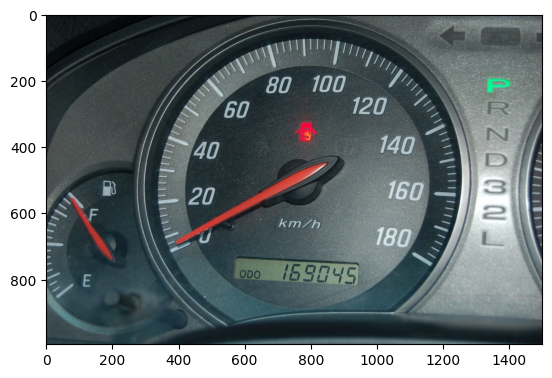

In [54]:
img = Image.open('mileage.jpg')
mileage_odometer(img)

odometer probs: [[0.3904  0.586   0.02345]]
Требуется фотография одометра, где виден пробег


1

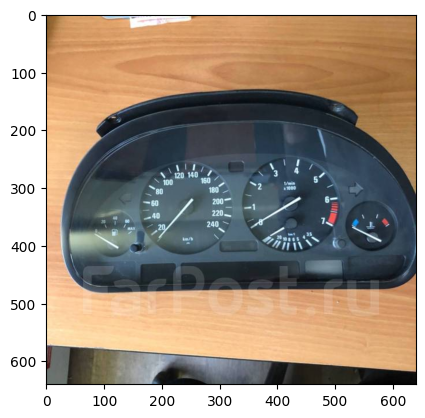

In [55]:
img = Image.open('not_odometer.jpeg')
mileage_odometer(img)

odometer probs: [[0.636  0.2198 0.1442]]


0

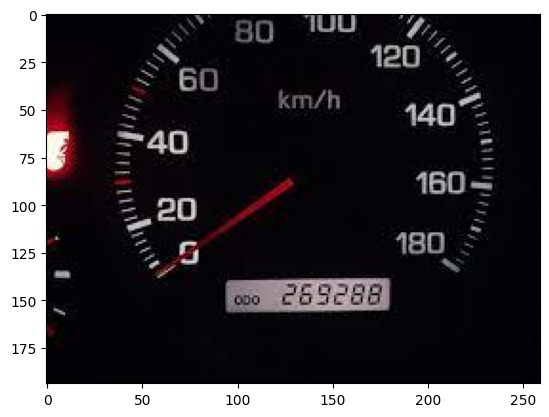

In [56]:
img = Image.open('good_odo.jpeg')
mileage_odometer(img)

# Салон автомобиля, передняя часть с приборной панелью

In [184]:
def interior_front(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["car interior front part", "not front part of car interior, or not interior", "car interior back seats"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("interior front probs:", probs) 

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0]:
        flag = 1
        print('Требуется фотография передней части салона автомобиля с приборной панелью') 
        

    return flag  

interior front probs: [[0.7334 0.0661 0.2004]]


0

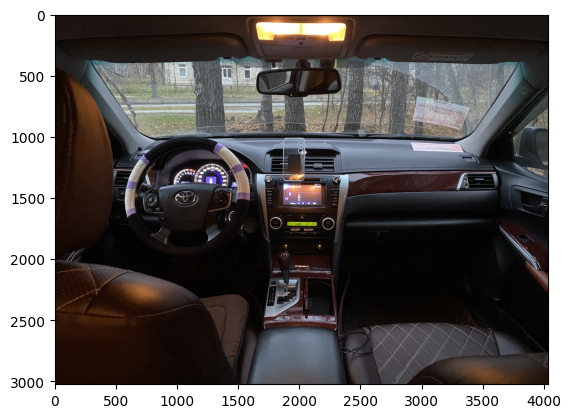

In [192]:
img = Image.open('IMG_8431.jpg')
interior_front(img)

interior front probs: [[0.901   0.06323 0.03604]]


0

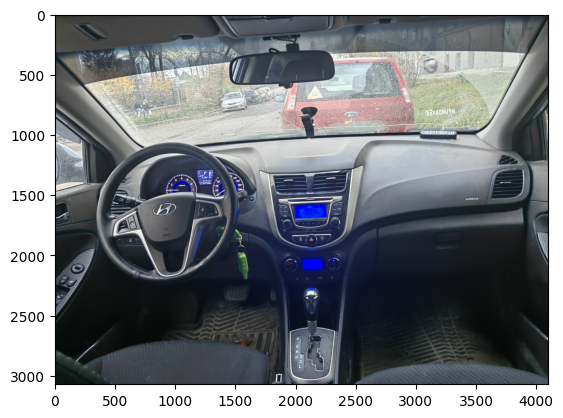

In [186]:
img = Image.open('my_front_interior.jpg')
interior_front(img)

interior front probs: [[0.296  0.1334 0.571 ]]
Требуется фотография передней части салона автомобиля с приборной панелью


1

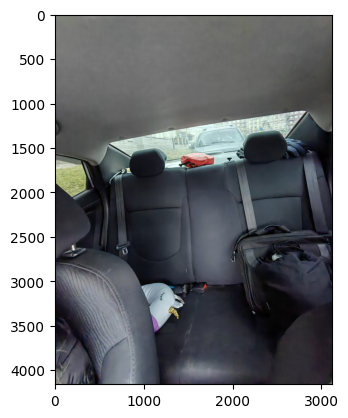

In [187]:
img = Image.open('my_back_interior.jpg')
interior_front(img)

interior front probs: [[0.8496  0.05963 0.09094]]


0

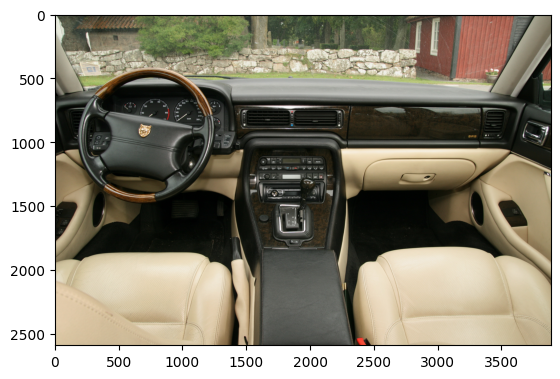

In [188]:
img = Image.open('front_interior.jpg')
interior_front(img)

interior front probs: [[0.2325  0.02866 0.739  ]]
Требуется фотография передней части салона автомобиля с приборной панелью


1

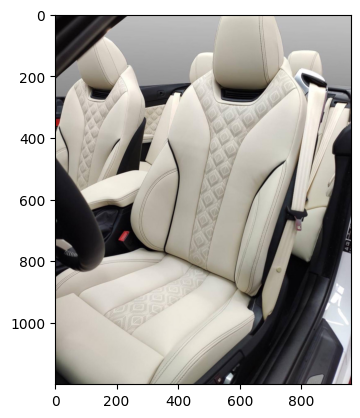

In [189]:
img = Image.open('bad_front_interior.jpg')
interior_front(img)

interior front probs: [[0.3875 0.0576 0.555 ]]
Требуется фотография передней части салона автомобиля с приборной панелью


1

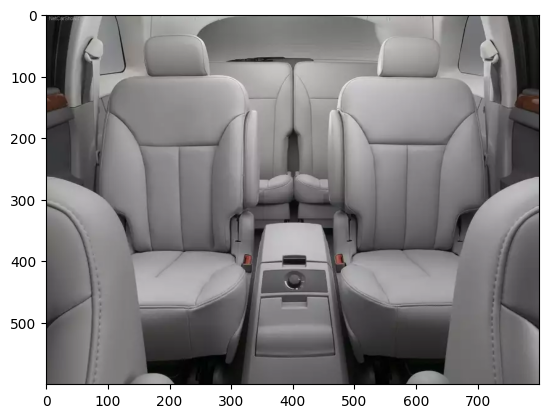

In [190]:
img = Image.open('back_interior.webp')
interior_front(img)

# Задняя часть салона

In [63]:
def interior_back(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["car interior back part with seats", "car interior front part with panel", "not car or car exterior"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("interior back probs:", probs) 

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0]:
        flag = 1
        print('Требуется фотография задней части салона автомобиля') 
        

    return flag  

interior back probs: [[0.795    0.1979   0.007435]]


0

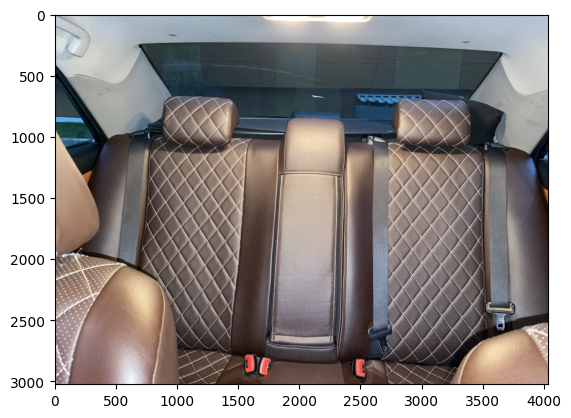

In [194]:
img = Image.open('IMG_8432.jpg')
interior_back(img)

interior back probs: [[0.4587 0.4958 0.0454]]
Требуется фотография задней части салона автомобиля


1

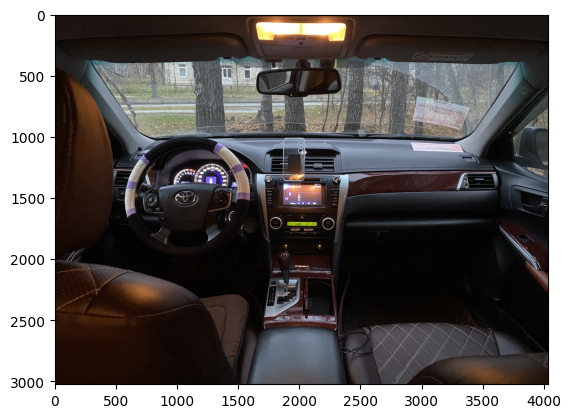

In [195]:
img = Image.open('IMG_8431.jpg')
interior_back(img)

interior back probs: [[0.003685 0.00617  0.99    ]]
Требуется фотография задней части салона автомобиля


1

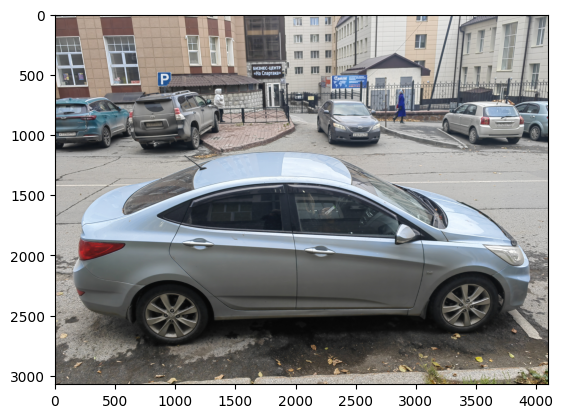

In [64]:
img = Image.open('my_car.jpg')
interior_back(img)

interior back probs: [[0.659  0.2314 0.1093]]


0

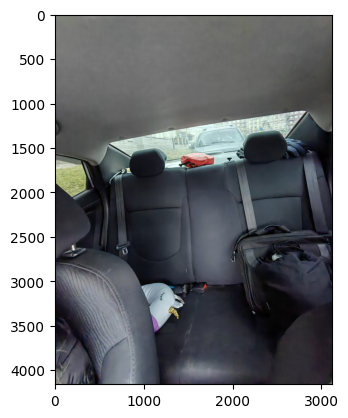

In [65]:
img = Image.open('my_back_interior.jpg')
interior_back(img)

interior back probs: [[0.2898  0.6953  0.01512]]
Требуется фотография задней части салона автомобиля


1

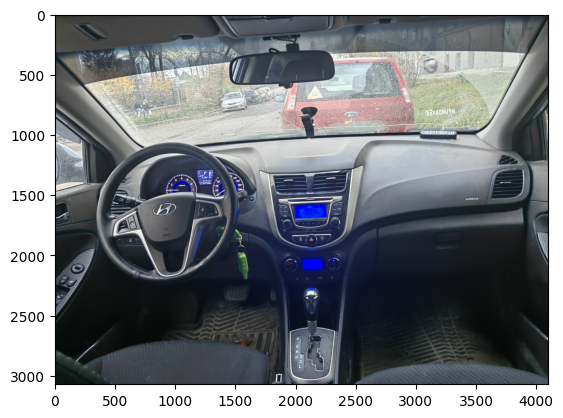

In [66]:
img = Image.open('my_front_interior.jpg')
interior_back(img)

interior back probs: [[0.7363 0.1862 0.0776]]


0

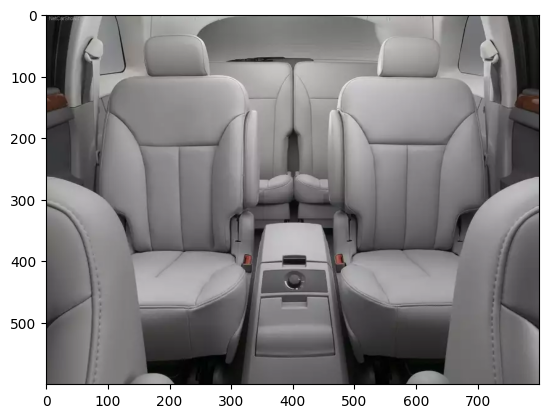

In [67]:
img = Image.open('back_interior.webp')
interior_back(img)

interior back probs: [[0.279   0.68    0.04083]]
Требуется фотография задней части салона автомобиля


1

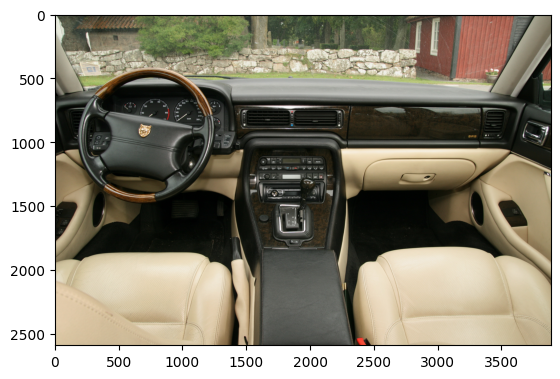

In [68]:
img = Image.open('front_interior.jpg')
interior_back(img)

# **Неограниченное количество фото повреждений автомобиля (при наличии)**
# Решил проверять СТЕПЕНЬ повреждения, сильное или слабое

In [69]:
def car_damage(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["severe damaged car", "scratches on the car", "car dent", "car is not damaged"]).to(device)
    plt.imshow(img)
#     flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()
    print("damage probs:", probs) 
    

    maxprob = probs[0].argmax()
    
    if probs[0][0] > 0.4:
        print('Сильные повреждения')
    if probs[0][1] > 0.4:
        print('Царапины')   
    if probs[0][2] > 0.4:
        print('Вмятины')       
        

#     return flag  

damage probs: [[0.5034  0.03072 0.0611  0.4045 ]]
Сильные повреждения


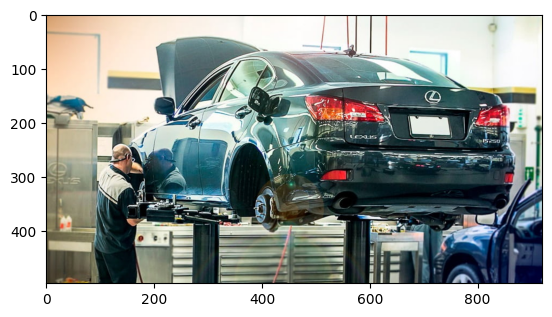

In [70]:
img = Image.open("repair_car.jpg")
car_damage(img)

damage probs: [[0.02419 0.696   0.2683  0.01179]]
Царапины


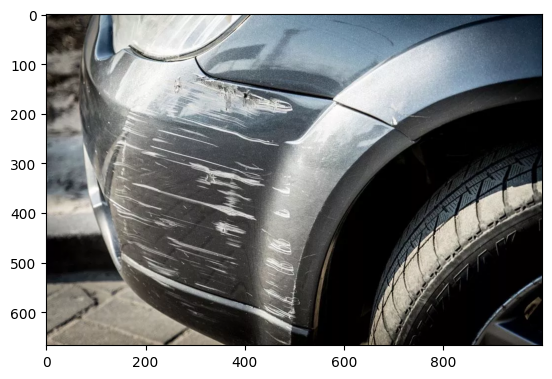

In [71]:
img = Image.open("scratches.webp")
car_damage(img)

damage probs: [[0.117   0.0856  0.787   0.01038]]
Вмятины


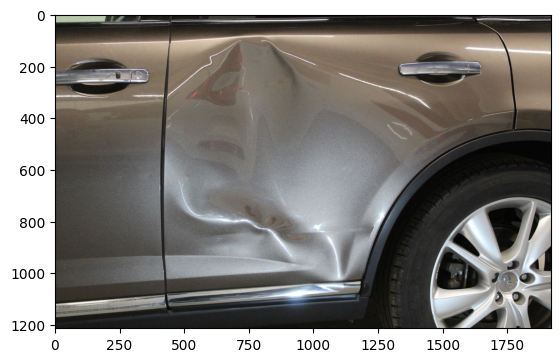

In [72]:
img = Image.open("dent.jpg")
car_damage(img)

damage probs: [[0.169  0.1198 0.0836 0.6274]]


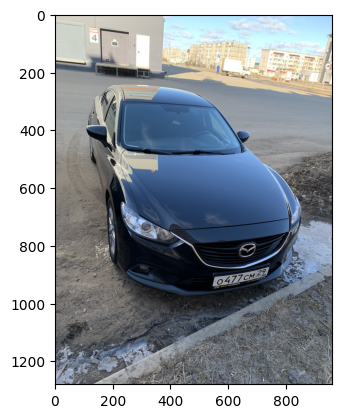

In [73]:
img = Image.open("clean_car.jpg")
car_damage(img)

damage probs: [[0.2269  0.03534 0.1398  0.598  ]]


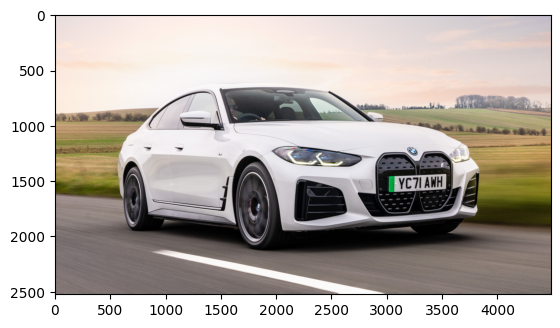

In [74]:
img = Image.open("car.jpg")
car_damage(img)

# Фотографии ключей, брелоков, иммобилайзеров автомобиля

In [75]:
def car_keys(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["car keys", "car alarm keychain", "the keys for house", "not keys", "car"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()
    print("key probs:", probs) 
    

    maxprob = probs[0].argmax()
    
    if maxprob == 0 or maxprob == 1:
        print('Ключи от машины или брелок сигнализации')  
    if maxprob == 2 or maxprob == 3 or maxprob == 4:
        print('По фотографии нельзя понять, что это ключи от машины или брелок сигнализации')     
        flag = 1
    return flag    
        

key probs: [[0.11926  0.854    0.00349  0.02206  0.001116]]
Ключи от машины или брелок сигнализации


0

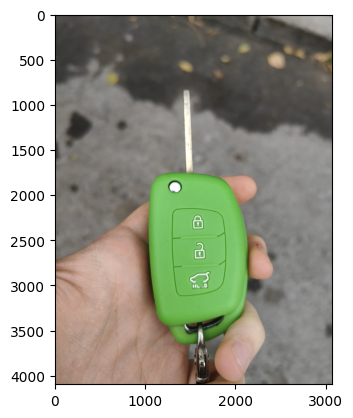

In [76]:
img = Image.open("my_keys.jpg")
car_keys(img)

key probs: [[0.127   0.543   0.00558 0.06384 0.2605 ]]
Ключи от машины или брелок сигнализации


0

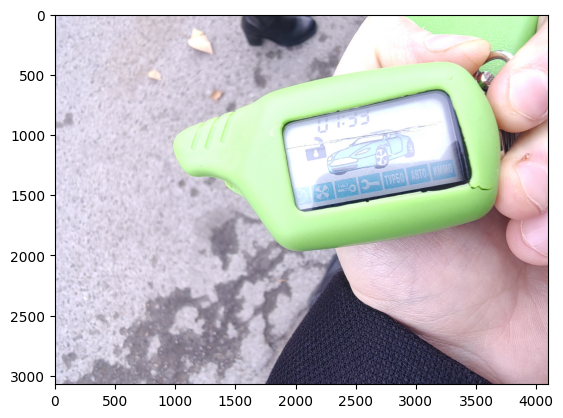

In [77]:
img = Image.open("my_alarm.jpg")
car_keys(img)

key probs: [[4.2633e-02 9.5557e-01 3.1710e-05 1.2165e-04 1.6537e-03]]
Ключи от машины или брелок сигнализации


0

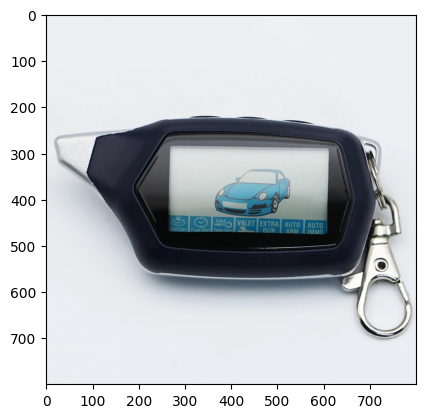

In [78]:
img = Image.open("alarm_key.jpg")
car_keys(img)

key probs: [[0.6353   0.3296   0.005943 0.02663  0.002806]]
Ключи от машины или брелок сигнализации


0

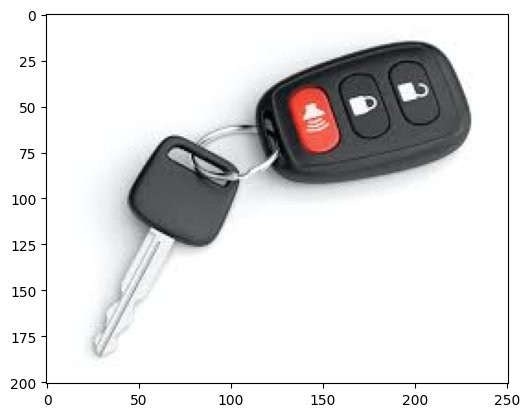

In [79]:
img = Image.open("car_keys.jpeg")
car_keys(img)

key probs: [[0.57     0.4104   0.002024 0.00907  0.00865 ]]
Ключи от машины или брелок сигнализации


0

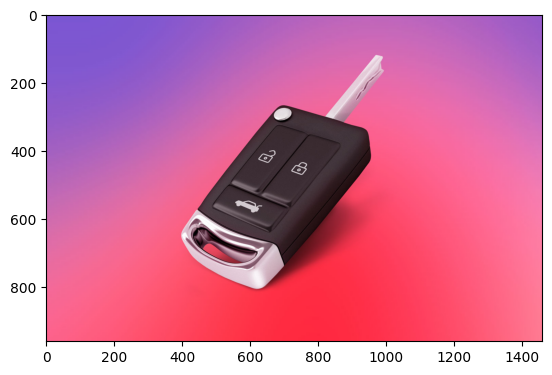

In [80]:
img = Image.open("car_immobilizer.jpg")
car_keys(img)

key probs: [[2.307e-02 2.214e-03 7.524e-01 2.224e-01 8.583e-05]]
По фотографии нельзя понять, что это ключи от машины или брелок сигнализации


1

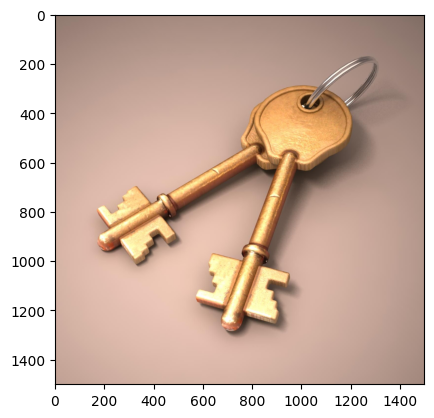

In [81]:
img = Image.open("not_car_keys.jpg")
car_keys(img)

key probs: [[8.812e-03 3.161e-04 1.526e-05 3.242e-03 9.878e-01]]
По фотографии нельзя понять, что это ключи от машины или брелок сигнализации


1

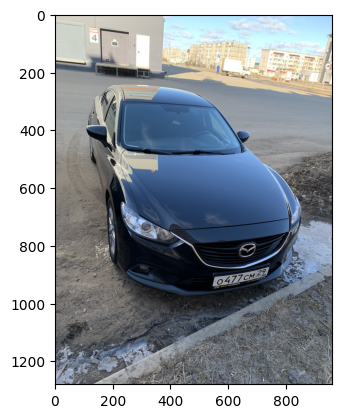

In [82]:
img = Image.open("clean_car.jpg")
car_keys(img)

# Требования к загородному дому

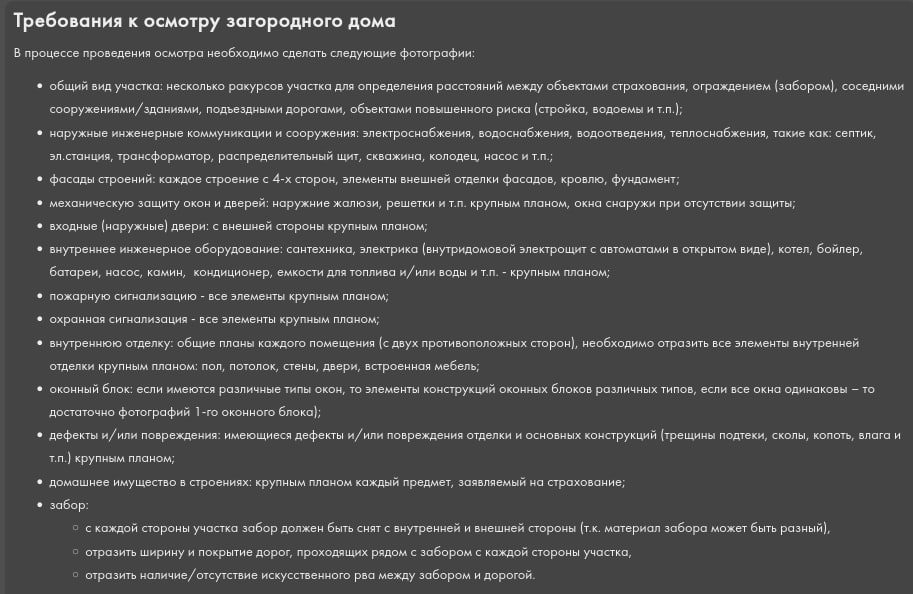

# Общий вид участка: несколько ракурсов для определения расстояний м/у ...

In [83]:
def country_house(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["real country house", "not a country house", "drawing of a country house"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("country house probs:", probs) 

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0]:
        flag = 1
        print('Требуется фотография общего вида настоящего участка загородного дома') 
        

    return flag  

country house probs: [[0.103   0.02094 0.876  ]]
Требуется фотография общего вида настоящего участка загородного дома


1

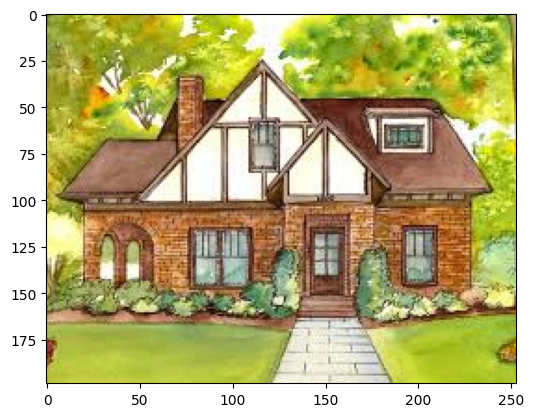

In [84]:
img = Image.open("house_drawing.jpeg")
country_house(img)

country house probs: [[0.388    0.6104   0.001537]]
Требуется фотография общего вида настоящего участка загородного дома


1

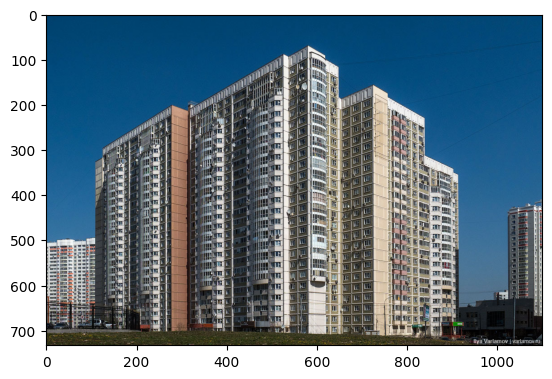

In [85]:
img = Image.open("mnogoetazhka.jpg")
country_house(img)

country house probs: [[0.8584   0.1401   0.001631]]


0

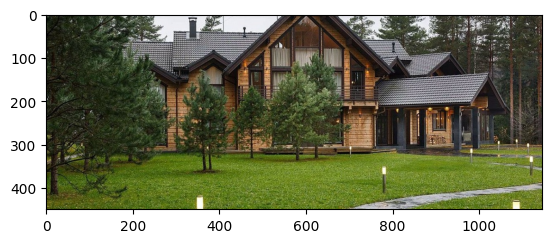

In [86]:
img = Image.open("country_house_general.jpg")
country_house(img)

country house probs: [[0.897    0.09906  0.004025]]


0

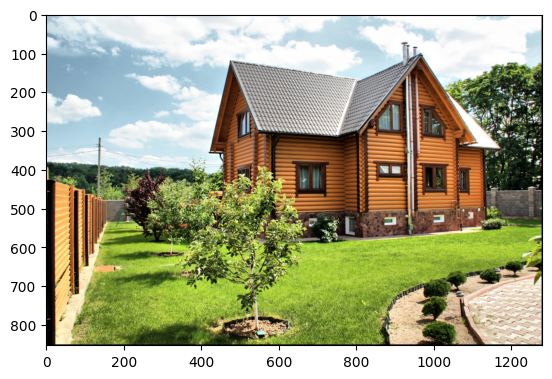

In [87]:
img = Image.open("country_house_general_2.jpg")
country_house(img)

# Наружные инженерные коммуникации(септик, эл.станция, трансформатор, распределительный щит, скважина, колодец и т.п)

In [88]:
def external_engeneering(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["external engineering communications and structures outside of country house", "just country house", "not a country house", "in house engineering communications and inside house structures",]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("external engineering communications and structures probs:", probs) 

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0] or probs[0][3] > probs[0][0]:
        flag = 1
        print('Требуется фотография наружных инженерных коммуникаций и сооружений участка вашего загородного дома') 
        

    return flag  

external engineering communications and structures probs: [[0.03574  0.839    0.1171   0.008224]]
Требуется фотография наружных инженерных коммуникаций и сооружений участка вашего загородного дома


1

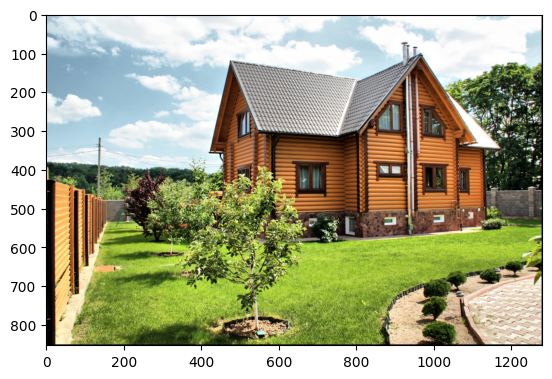

In [89]:
img = Image.open("country_house_general_2.jpg")
external_engeneering(img)

external engineering communications and structures probs: [[0.2478 0.0617 0.1576 0.5327]]
Требуется фотография наружных инженерных коммуникаций и сооружений участка вашего загородного дома


1

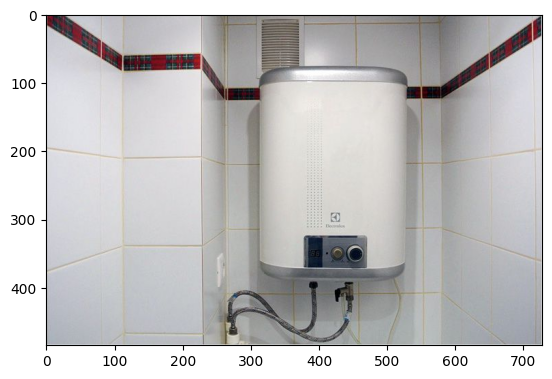

In [90]:
img = Image.open("boiler.jpg")
external_engeneering(img)

external engineering communications and structures probs: [[0.6963  0.059   0.05124 0.1934 ]]


0

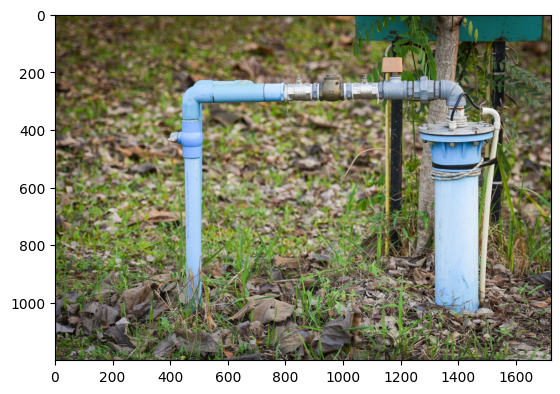

In [91]:
img = Image.open("well.jpg")
external_engeneering(img)

external engineering communications and structures probs: [[0.759    0.005276 0.0318   0.2042  ]]


0

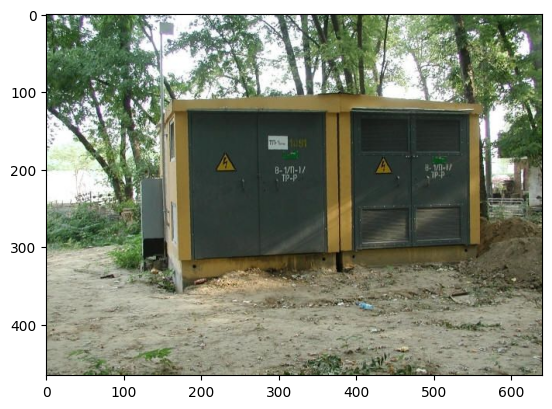

In [92]:
img = Image.open("electric_station.jpg")
external_engeneering(img)

# Фасады с 4-х сторон (проверить, что 4 фото, элементы отделки-??), кровля, фундамент

In [93]:
def facade(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["country house facade", "not a facade"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("facade probs:", probs) 

    if probs[0][1] > probs[0][0]:
        flag = 1
        print('Требуется фотография фасада загородного дома') 
        

    return flag  

facade probs: [[0.939   0.06097]]


0

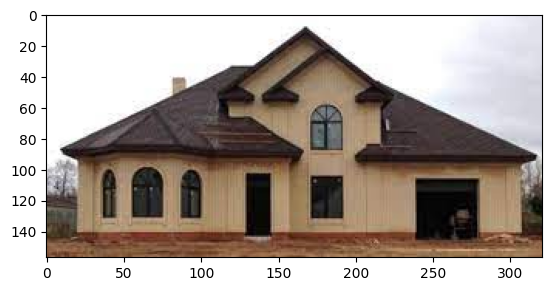

In [94]:
img = Image.open("facade.jpeg")
facade(img)

facade probs: [[0.967   0.03308]]


0

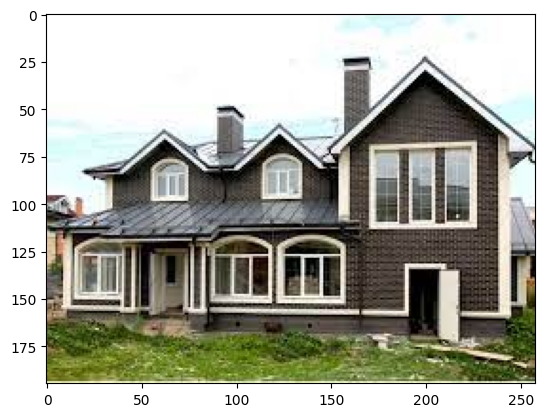

In [95]:
img = Image.open("facade_2.jpeg")
facade(img)

facade probs: [[0.1919 0.808 ]]
Требуется фотография фасада загородного дома


1

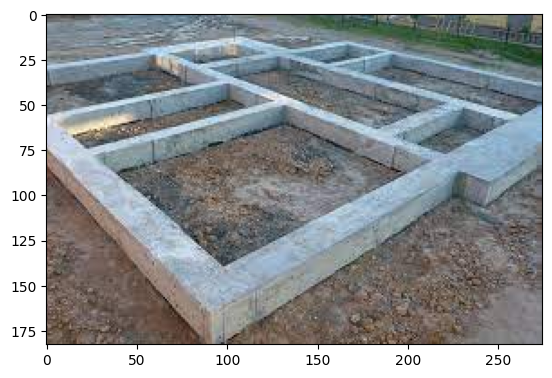

In [96]:
img = Image.open("foundation.jpeg")
facade(img)

facade probs: [[0.9766  0.02333]]


0

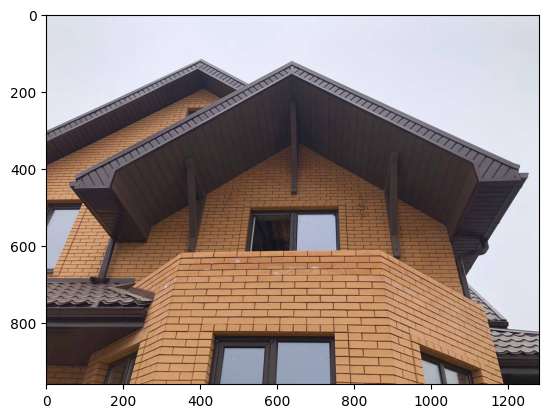

In [97]:
img = Image.open("house_front_part.jpg")
facade(img)

facade probs: [[0.002737 0.997   ]]
Требуется фотография фасада загородного дома


1

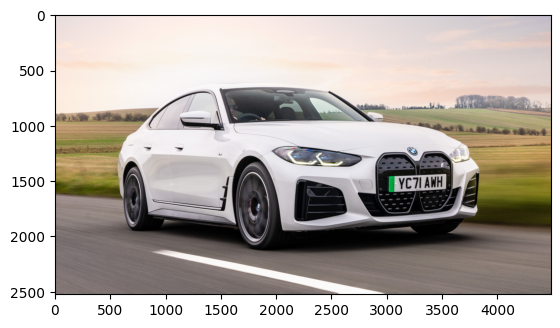

In [98]:
img = Image.open("car.jpg")
facade(img)

# Окна с наружными жалюзи, решетками; окна как есть, если нет защиты

In [99]:
def window(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["house window with grill", "house window with external blinds", 'house window without grills and without screens', 'not a window', 'just house']).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("window probs:", probs) 
    maxprob = probs[0].argmax()
    if maxprob == 3 or maxprob == 4:
        flag = 1
        print('Требуется фотография окон/наружных жалюзи/решеток на окнах') 
    if maxprob == 2:
        print('Окно без защиты')     
    if maxprob == 1 or maxprob == 0:
        print('Окно с наружным жалюзи или решеткой')     

    return flag  

window probs: [[0.1263  0.00771 0.02733 0.786   0.05228]]
Требуется фотография окон/наружных жалюзи/решеток на окнах


1

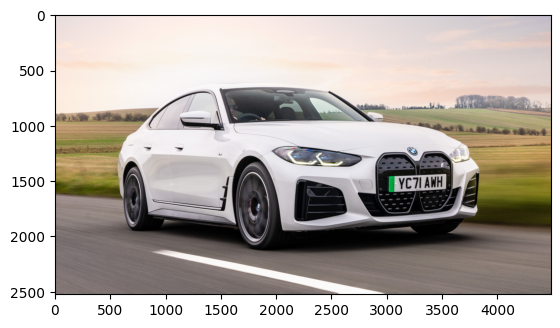

In [100]:
img = Image.open("car.jpg")
window(img)

window probs: [[0.1372   0.1192   0.03992  0.006832 0.697   ]]
Требуется фотография окон/наружных жалюзи/решеток на окнах


1

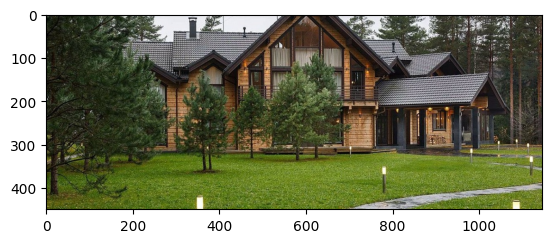

In [101]:
img = Image.open("country_house_general.jpg")
window(img)

window probs: [[4.612e-01 4.612e-01 7.648e-02 1.379e-03 9.894e-06]]
Окно с наружным жалюзи или решеткой


0

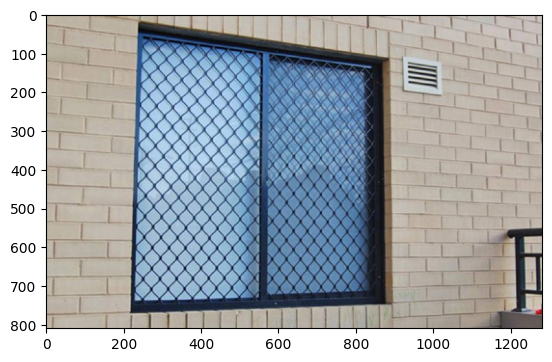

In [102]:
img = Image.open("window_grilles.jpg")
window(img)

window probs: [[0.8525   0.05536  0.0818   0.00773  0.002712]]
Окно с наружным жалюзи или решеткой


0

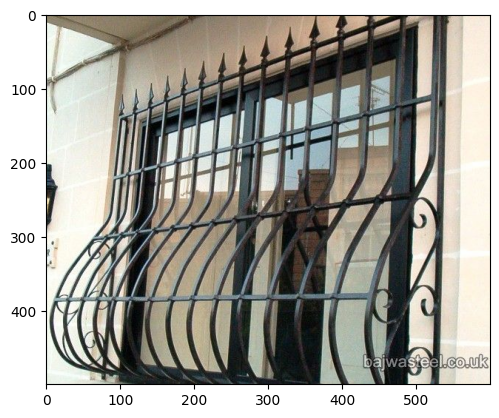

In [103]:
img = Image.open("window_grills.jpg")
window(img)

window probs: [[4.233e-02 8.115e-01 2.690e-02 7.515e-04 1.187e-01]]
Окно с наружным жалюзи или решеткой


0

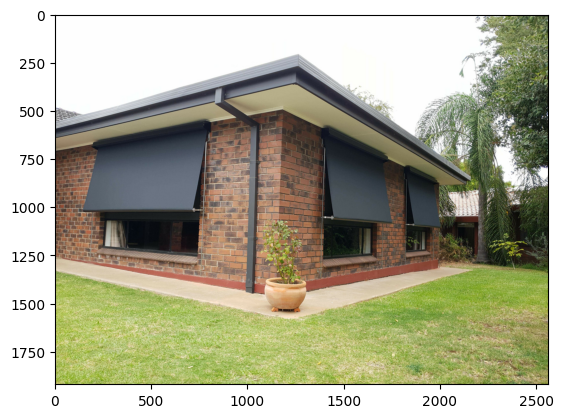

In [104]:
img = Image.open("window_blinds.jpg")
window(img)

window probs: [[1.969e-01 3.916e-01 4.041e-01 6.954e-03 2.654e-04]]
Окно без защиты


0

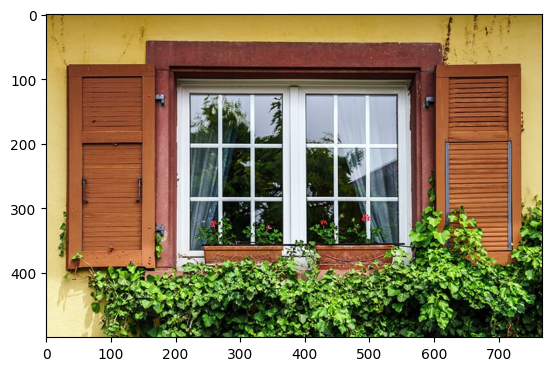

In [105]:
img = Image.open("window.jpg")
window(img)

# Двери снаружи крупным планом

In [106]:
def doors(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["country house doors close up", "not a country house", "just country house"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("door probs:", probs) 

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0]:
        flag = 1
        print('Требуется фотография дверей снаружи крупным планом') 
        

    return flag  

door probs: [[0.982   0.00993 0.00823]]


0

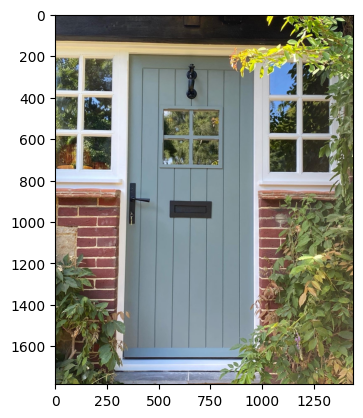

In [107]:
img = Image.open("doors.JPG")
doors(img)

door probs: [[0.05997 0.2646  0.6753 ]]
Требуется фотография дверей снаружи крупным планом


1

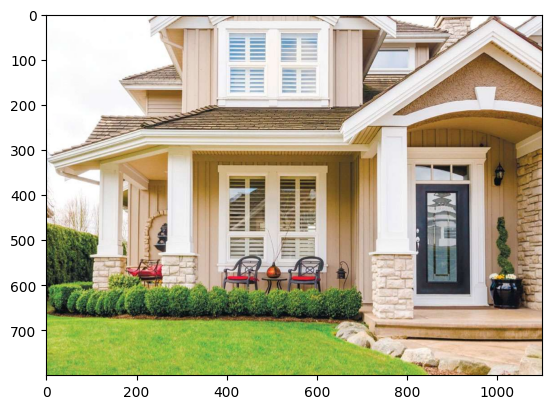

In [108]:
img = Image.open("house.jpg")
doors(img)

# Внутреннее инженерное оборудование

In [109]:
def internal_engeneering(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["external engineering communications and structures outside of country house", "just country house", "not a country house", "in house engineering communications and inside house structures",]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("internal engineering communications and structures probs:", probs) 

    if probs[0][1] > probs[0][3] or probs[0][2] > probs[0][3] or probs[0][0] > probs[0][3]:
        flag = 1
        print('Требуется фотография внутренних инженерных коммуникаций и сооружений вашего дома') 
        

    return flag  

internal engineering communications and structures probs: [[0.02626 0.6772  0.2651  0.03119]]
Требуется фотография внутренних инженерных коммуникаций и сооружений вашего дома


1

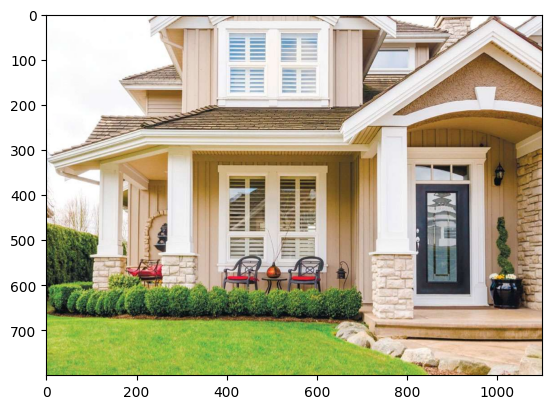

In [110]:
img = Image.open("house.jpg")
internal_engeneering(img)

internal engineering communications and structures probs: [[0.2478 0.0617 0.1576 0.5327]]


0

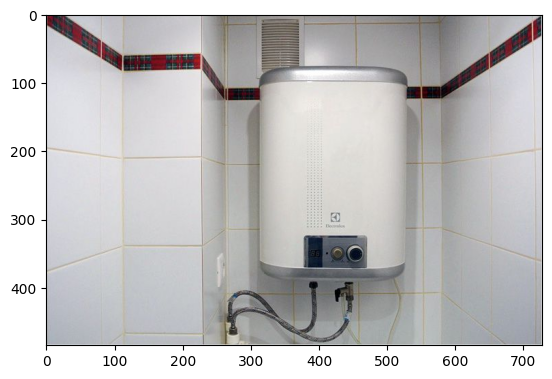

In [111]:
img = Image.open("boiler.jpg")
internal_engeneering(img)

internal engineering communications and structures probs: [[0.0645 0.1    0.1525 0.683 ]]


0

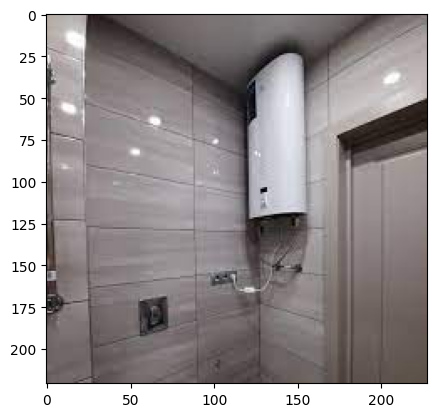

In [112]:
img = Image.open("boiler.jpeg")
internal_engeneering(img)

internal engineering communications and structures probs: [[0.759    0.005276 0.0318   0.2042  ]]
Требуется фотография внутренних инженерных коммуникаций и сооружений вашего дома


1

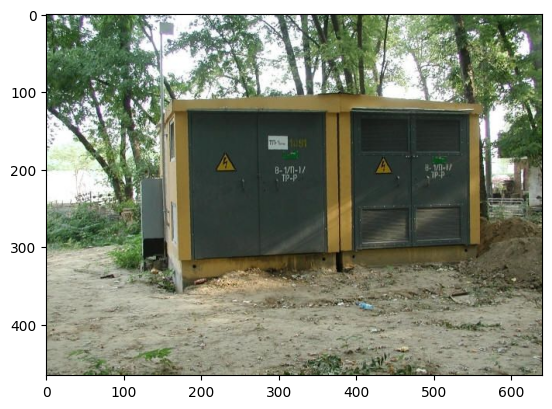

In [113]:
img = Image.open("electric_station.jpg")
internal_engeneering(img)

internal engineering communications and structures probs: [[0.6963  0.059   0.05124 0.1934 ]]
Требуется фотография внутренних инженерных коммуникаций и сооружений вашего дома


1

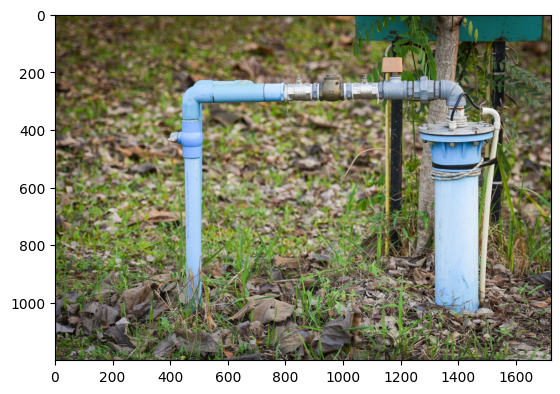

In [114]:
img = Image.open("well.jpg")
internal_engeneering(img)

# Пожарная сигнализация крупным планом

In [115]:
def fire_alarm(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["close-up photo of fire alarm", "not a fire alarm or security alarm", "difficult to see fire alarm", "security alarm system"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("fire alarm probs:", probs) 

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0] or probs[0][3] > probs[0][0]:
        flag = 1
        print('Требуется фотография пожарной сигнализации крупным планом') 
        

    return flag  

fire alarm probs: [[6.599e-04 9.552e-03 4.680e-04 9.893e-01]]
Требуется фотография пожарной сигнализации крупным планом


1

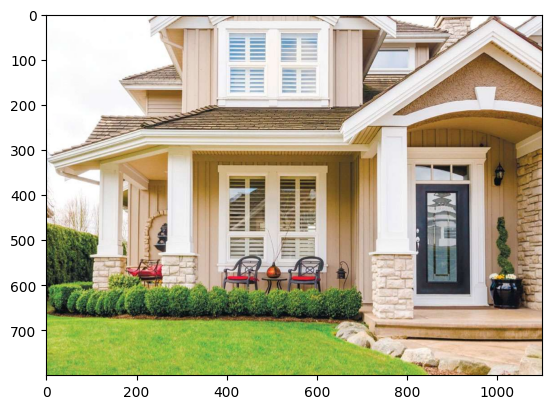

In [116]:
img = Image.open("house.jpg")
fire_alarm(img)

fire alarm probs: [[0.9585   0.01869  0.002031 0.02084 ]]


0

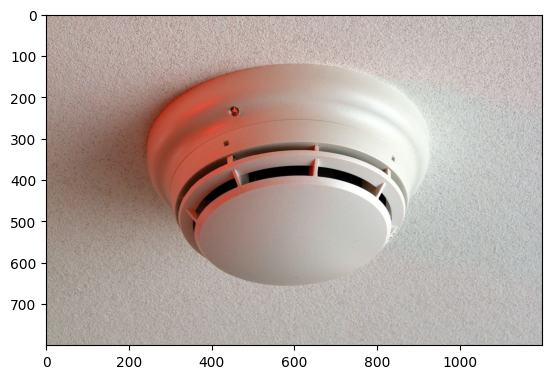

In [117]:
img = Image.open("fire_alarm.jpg")
fire_alarm(img)

fire alarm probs: [[9.956e-01 1.078e-03 8.135e-04 2.710e-03]]


0

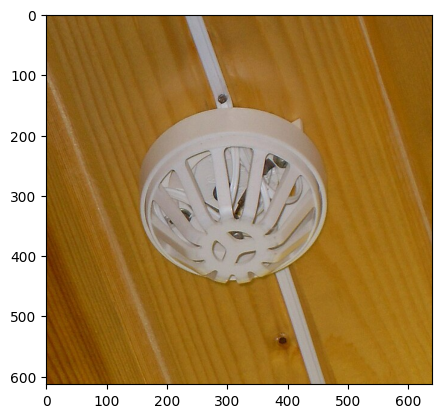

In [118]:
img = Image.open("fire_alarm_2.jpg")
fire_alarm(img)

fire alarm probs: [[0.11035  0.02042  0.001347 0.8677  ]]
Требуется фотография пожарной сигнализации крупным планом


1

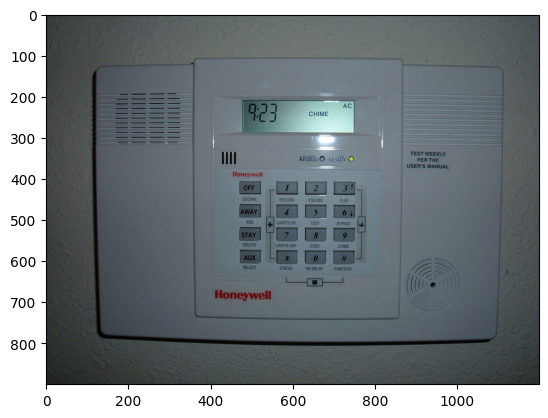

In [119]:
img = Image.open('security_alarm.jpg')
fire_alarm(img)

# Охранная сигнализация крупным планом

In [120]:
def security_alarm(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["close-up photo of security alarm", "not a security alarm", "difficult to see security alarm", "close-up photo of fire alarm"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("security alarm probs:", probs) 

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0] or probs[0][3] > probs[0][0]:
        flag = 1
        print('Требуется фотография охранной сигнализации крупным планом') 
        

    return flag  

security alarm probs: [[0.935    0.002354 0.0234   0.0392  ]]


0

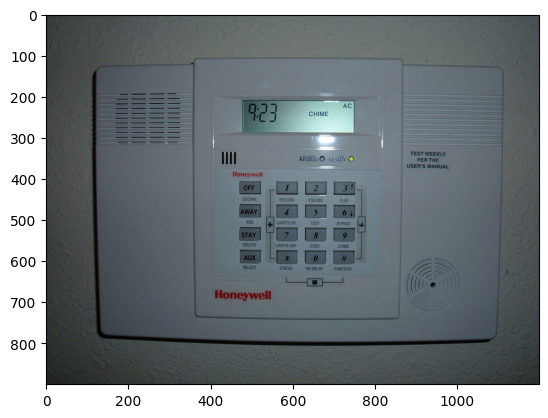

In [121]:
img = Image.open('security_alarm.jpg')
security_alarm(img)

security alarm probs: [[0.375    0.001005 0.005608 0.618   ]]
Требуется фотография охранной сигнализации крупным планом


1

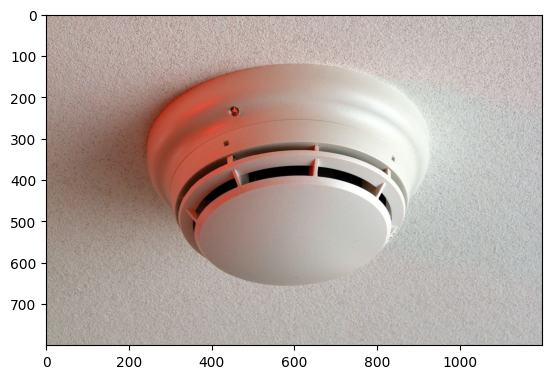

In [122]:
img = Image.open('fire_alarm.jpg')
security_alarm(img)

security alarm probs: [[0.04156  0.3428   0.611    0.004665]]
Требуется фотография охранной сигнализации крупным планом


1

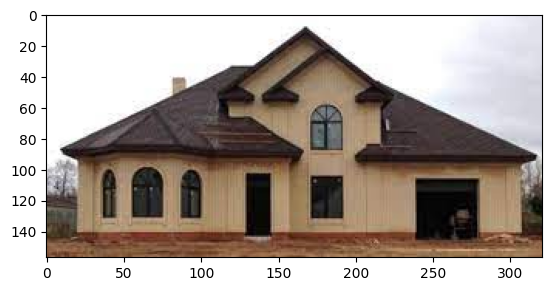

In [123]:
img = Image.open('facade.jpeg')
security_alarm(img)

# Общие планы каждого помещения (должно быть видно и пол, и потолок, и стены, и двери, и мебель)

In [124]:
def room_view(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["general view of the room", "not a room", "separate piece of furniture"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("room probs:", probs) 

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0]:
        flag = 1
        print('Требуется фотографии общего плана помещения (постарайтесь, чтобы было видно и пол, и потолок, и стены, и двери, и мебель)') 
        

    return flag 

room probs: [[0.002285 0.001114 0.9966  ]]
Требуется фотографии общего плана помещения (постарайтесь, чтобы было видно и пол, и потолок, и стены, и двери, и мебель)


1

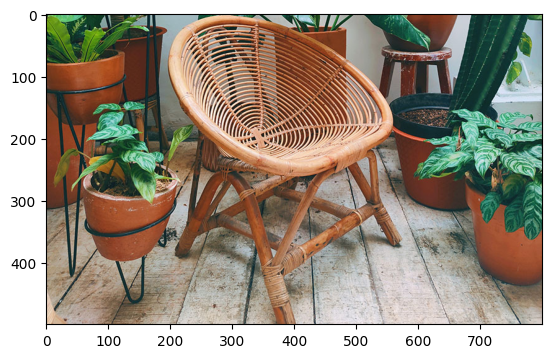

In [125]:
img = Image.open('stool.jpg')
room_view(img)

room probs: [[0.02399 0.01755 0.9585 ]]
Требуется фотографии общего плана помещения (постарайтесь, чтобы было видно и пол, и потолок, и стены, и двери, и мебель)


1

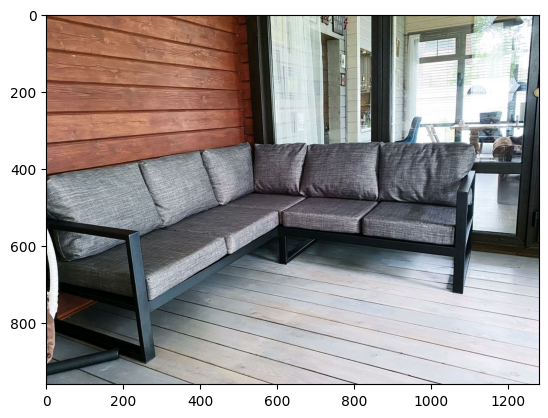

In [126]:
img = Image.open('divan.jpg')
room_view(img)

room probs: [[0.7544  0.06384 0.182  ]]


0

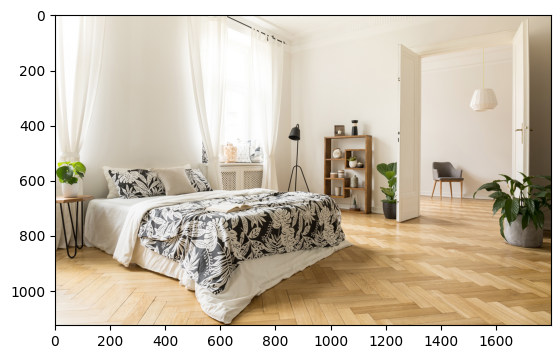

In [127]:
img = Image.open('room_2.jpg')
room_view(img)

room probs: [[0.9146  0.05582 0.0294 ]]


0

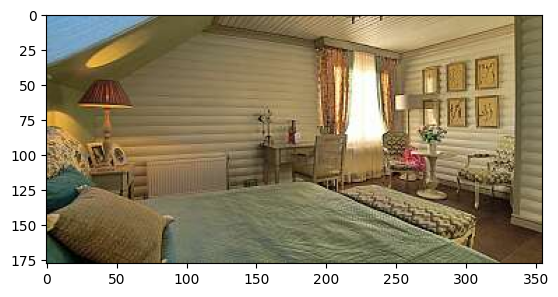

In [128]:
img = Image.open('room_3.jpg')
room_view(img)

# Окна внутри (если одного типа, то только одну фотографию, т.е. 1+ )

In [129]:
def window_inside(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["window inside room", "general view of the room", "not a window"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("window inside probs:", probs) 

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0]:
        flag = 1
        print('Требуется фотографии окон внутри дома, если они все однотипные, то достаточно одной фотографии') 
        

    return flag 

window inside probs: [[0.8887   0.003256 0.10785 ]]


0

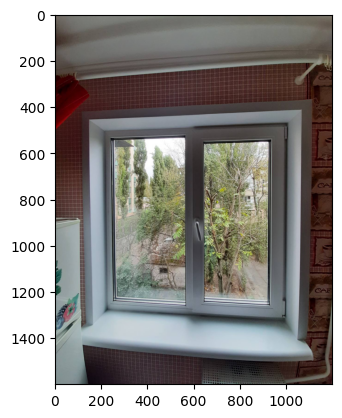

In [130]:
img = Image.open('window_inside.jpg')
window_inside(img)

window inside probs: [[0.9565   0.003191 0.0401  ]]


0

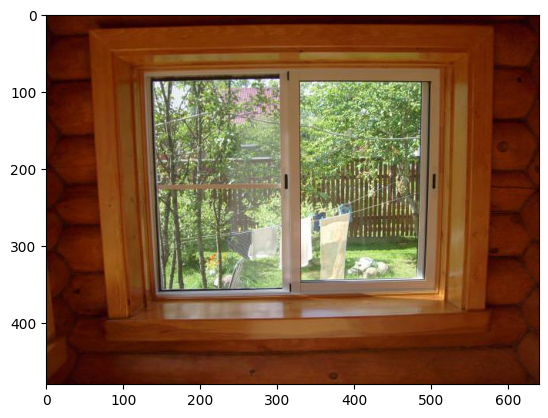

In [131]:
img = Image.open('window_inside_2.jpg')
window_inside(img)

window inside probs: [[0.1642 0.783  0.0525]]
Требуется фотографии окон внутри дома, если они все однотипные, то достаточно одной фотографии


1

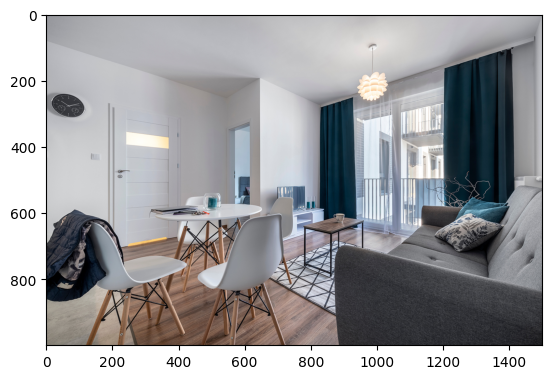

In [132]:
img = Image.open('room.jpg')
window_inside(img)

window inside probs: [[0.0832  0.00863 0.908  ]]
Требуется фотографии окон внутри дома, если они все однотипные, то достаточно одной фотографии


1

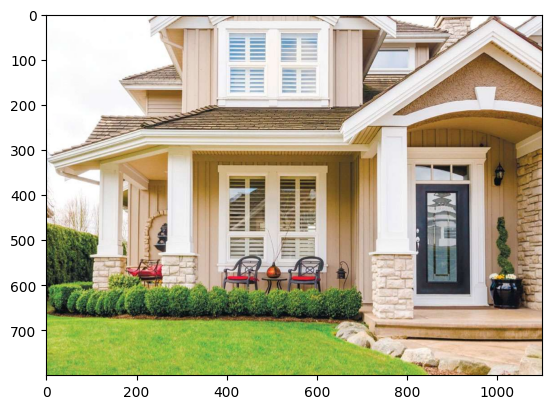

In [133]:
img = Image.open('house.jpg')
window_inside(img)

# Дефекты и повреждения: трещины, подтеки, копоть, сколы, влага (можно просто вести подсчет дефектов, или нужна отдельная нейросеть)

# Домашнее имущество (аналогично с предыдущим пунктом)

# Забор: с внешней и внутренней стороны, отразить ширину и покрытие дорог, наличие рва

In [134]:
def fence(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["fence", "not a fence", "window or house"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("fence probs:", probs) 

    if probs[0][1] > probs[0][0] or probs[0][2] > probs[0][0]:
        flag = 1
        print('Требуются фотографии забора с внешней и внутренней стороны, отразить близость дорог, наличие/отсутствие рва') 
    else: # нужно дообучать, в данной версии тяжело подобрать токен
        text = clip.tokenize(["outer fence side with road", "inner side of fence with territory"]).to(device)
        with torch.no_grad():
            image_features = model.encode_image(image)
            text_features = model.encode_text(text)

            logits_per_image, logits_per_text = model(image, text)
            probs = logits_per_image.softmax(dim=-1).cpu().numpy()
            print("fence side probs:", probs) 
        if probs[0][0] > probs[0][1]:
            print("Фотография забора снаружи")
        else:
            print("Фотография забора с внутренней стороны")
        
    return flag 

fence probs: [[0.5703 0.2131 0.2164]]
fence side probs: [[0.813  0.1871]]
Фотография забора снаружи


0

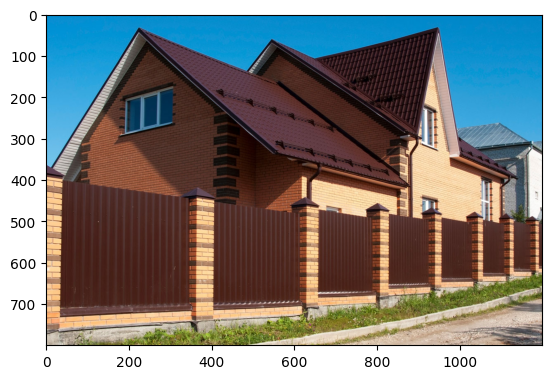

In [135]:
img = Image.open('fence_outside.jpeg')
fence(img)

fence probs: [[0.564    0.4324   0.003626]]
fence side probs: [[0.5195 0.4805]]
Фотография забора снаружи


0

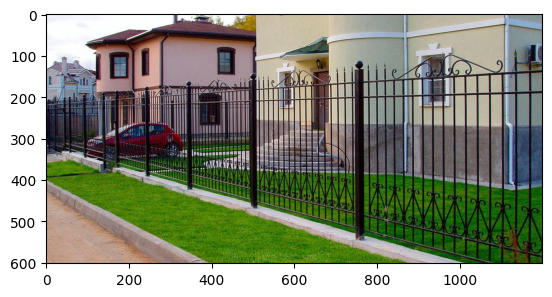

In [136]:
img = Image.open('fence_outside_2.jpg')
fence(img)

fence probs: [[1.398e-04 2.491e-04 9.995e-01]]
Требуются фотографии забора с внешней и внутренней стороны, отразить близость дорог, наличие/отсутствие рва


1

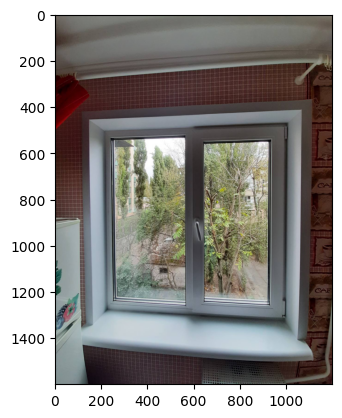

In [137]:
img = Image.open('window_inside.jpg')
fence(img)

fence probs: [[0.00164  0.004898 0.9937  ]]
Требуются фотографии забора с внешней и внутренней стороны, отразить близость дорог, наличие/отсутствие рва


1

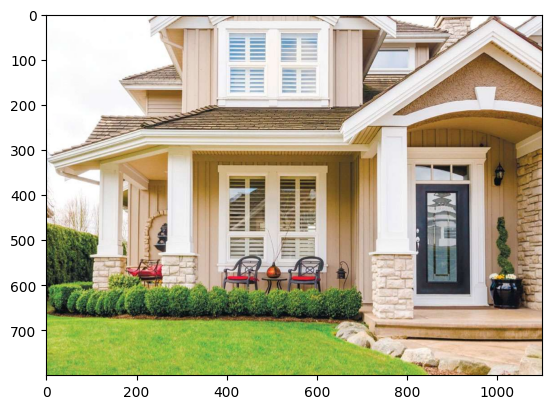

In [138]:
img = Image.open('house.jpg')
fence(img)

fence probs: [[0.69    0.2966  0.01366]]
fence side probs: [[0.3486 0.6514]]
Фотография забора с внутренней стороны


0

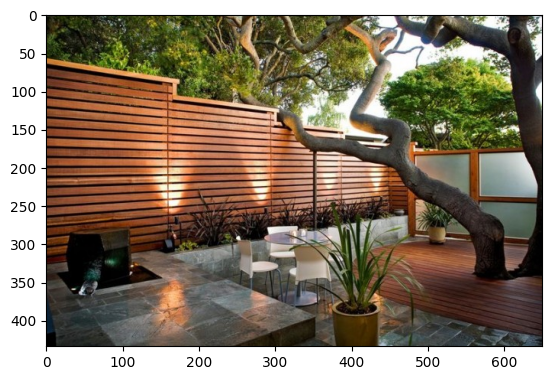

In [139]:
img = Image.open('fence_inside.jpg')
fence(img)

# Для случаев, когда отсутствуют документы, подтверждающие площадь строения необходимо клиенту дополнительно иметь возможность прикрепить нарисованную план-схему загородного дома

План-схема должна содержать следующую информацию:

* расположение объектов на участке, включая расстояние между строениями относительно крайних точек объектов, расстояние от объектов до ограждения;
* основные параметры объектов - внешние замеры длины, ширины, высоты;
* привязка объектов к улице/дороге/к ограждению участка.

 

In [140]:
def plan_diagram(img, device=device, model=model, preprocess=preprocess):
    """
        returns flag: if flag equals 0 then its ok, else if flag = 1 then its not
    """
    image = preprocess(img).unsqueeze(0).to(device)
    text = clip.tokenize(["private area plan diagram", "not a plan diagram of a private area"]).to(device)
    plt.imshow(img)
    flag = 0 
    
    with torch.no_grad():
        image_features = model.encode_image(image)
        text_features = model.encode_text(text)

        logits_per_image, logits_per_text = model(image, text)
        probs = logits_per_image.softmax(dim=-1).cpu().numpy()

    print("plan diagram probs:", probs) 

    if probs[0][1] > probs[0][0]:
        flag = 1
        print('Прикрепите план-схему загородного дома (при отстуствии документов, подтверждающих площадь)') 

        
    return flag 

plan diagram probs: [[0.8223 0.1779]]


0

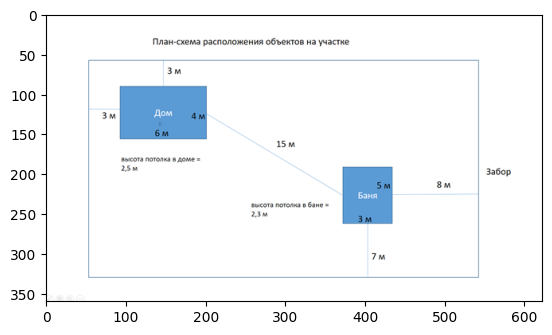

In [141]:
img = Image.open('scheme.png')
plan_diagram(img)

plan diagram probs: [[0.8354 0.1646]]


0

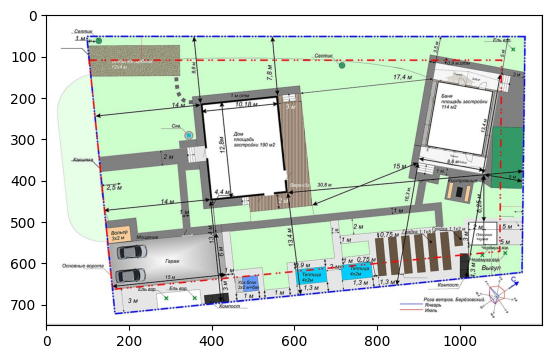

In [142]:
img = Image.open('plan.jpg')
plan_diagram(img)

plan diagram probs: [[0.1779 0.8223]]
Прикрепите план-схему загородного дома (при отстуствии документов, подтверждающих площадь)


1

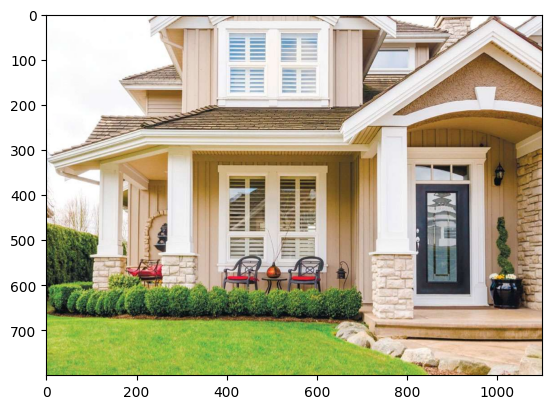

In [143]:
img = Image.open('house.jpg')
plan_diagram(img)

plan diagram probs: [[0.015305 0.985   ]]
Прикрепите план-схему загородного дома (при отстуствии документов, подтверждающих площадь)


1

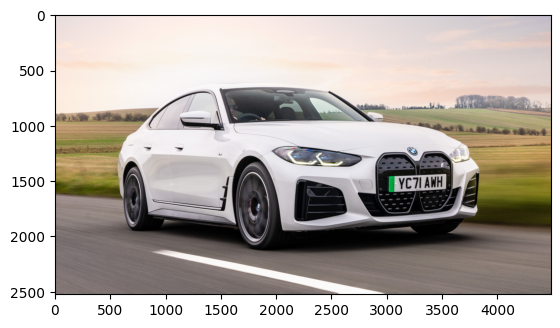

In [144]:
img = Image.open('car.jpg')
plan_diagram(img)